# Определения цвета автомобилей по фотографии

## Постановка задачи

На массиве изображений с автомобилями необходимо определить их цвет в пространстве RGB. Если на изображении несколько автомобилей, необходимо определить цвет для каждого. 

Используя открытые источники сформировать и подготовить выборку изображений с автомобилями. 

Входные данные:
Изображение
Выходные данные:
Список кортежей, каждый из которых содержит значения каналов RGB (три целых числа от 0 до 255) 


## Подготовка данных

Нам необходимо определить цвет автомобиля по картинке. Но у нас нет датасета, а значит для начала необходимо его создать. 

Загрузим для ручного тестирования 20 различных фотографий машин. Будем брать фото где всего 1 машина, несколько машин и вообще нет машин. Сложим эти фотографии в папку 'data'

## Подход к решению №1

Для начала попробуем самый простой алгоритм. Будем считать что на изображении один автомобиль и он достаточно большой. Тогда можно выделить фрагмент изображения по центру и взять его средний цвет.

Импортируем необходимые библиотеки

In [1]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

Напишем функцию, которая получает на вход адрес изображения и возвращает цвет автомобиля по самому простому алгоритму

In [2]:
def extract_car_colors_v1(image_path: str) -> tuple:

    image = cv2.imread(image_path)

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    height, width, _ = image_rgb.shape
    center_crop = image_rgb[height//3:2*height//3, width//3:2*width//3]

    average_color = np.mean(center_crop.reshape(-1, 3), axis=0)
    rgb_color = tuple(map(int, average_color))

    return rgb_color

Реализуем функционал, который будет нам отображать изображение, цвета автомобилей в числовом и графическом формате

In [3]:
def create_image_from_rgb(rgb_tuple: tuple, picture_size: list) -> np.array:
    image = np.full(picture_size, rgb_tuple,dtype='uint8')
    return image


def display_images(image_path: str, rgb_list: list):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = img.shape
    rgb_images = []
    for rgb in rgb_list:
        rgb_images.append(create_image_from_rgb(rgb, img_size))

    total_images = len(rgb_list) + 1
    file_name = os.path.basename(image_path)

    plt.figure(figsize=(15, 5))

    # Отображение исходного изображения
    plt.subplot(1, total_images, 1)
    plt.imshow(img)
    plt.title(f"Image name: {file_name}")
    plt.axis('off')

    # Отображение изображений с заданными цветами
    for i, rgb_img in enumerate(rgb_images):
        plt.subplot(1, total_images, i + 2)
        plt.imshow(rgb_img)
        plt.title(f"RGB: {rgb_list[i]}")
        plt.axis('off')

    plt.show()

Используем наш датасет для оценки результата

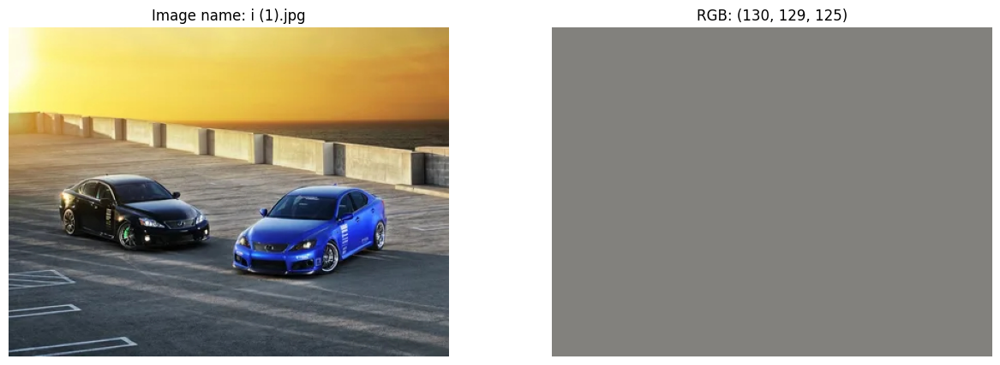

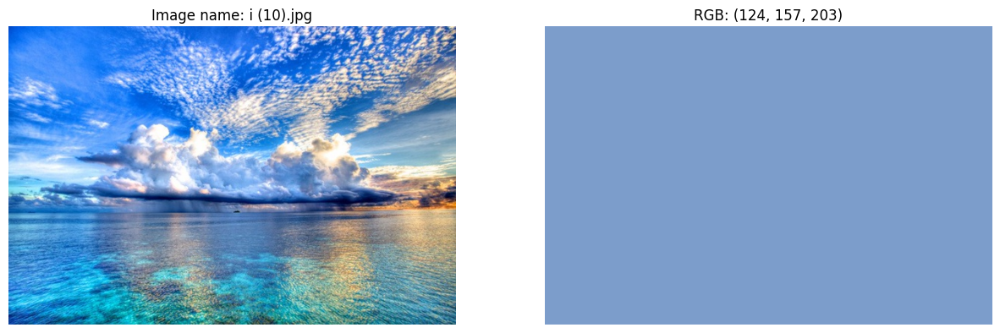

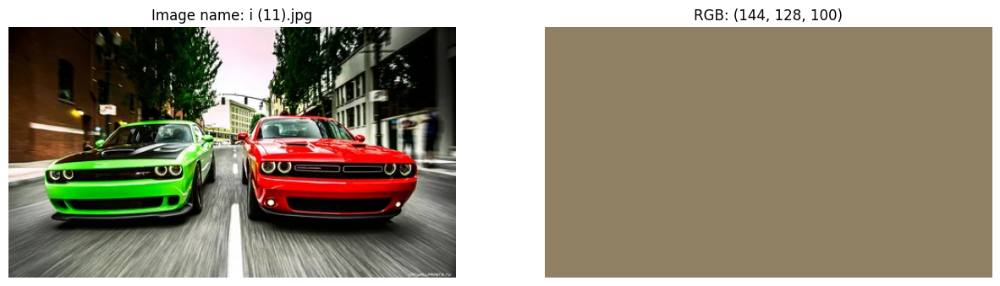

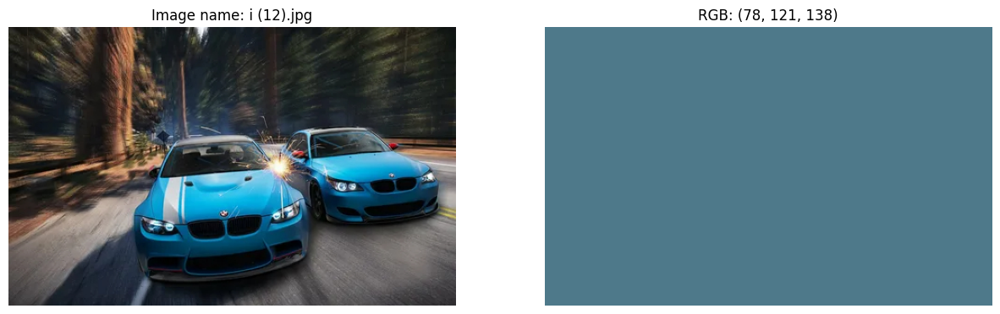

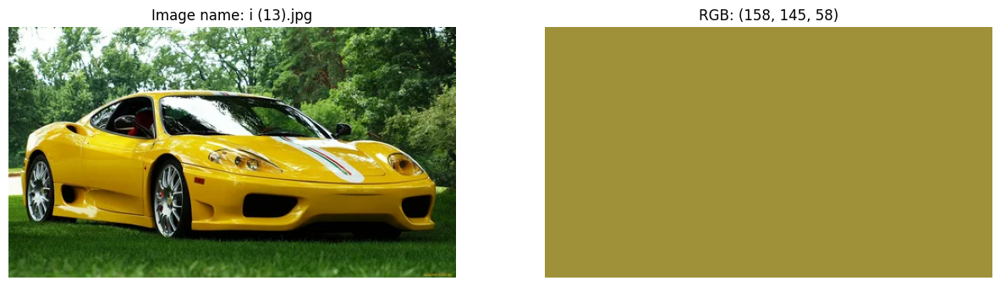

...

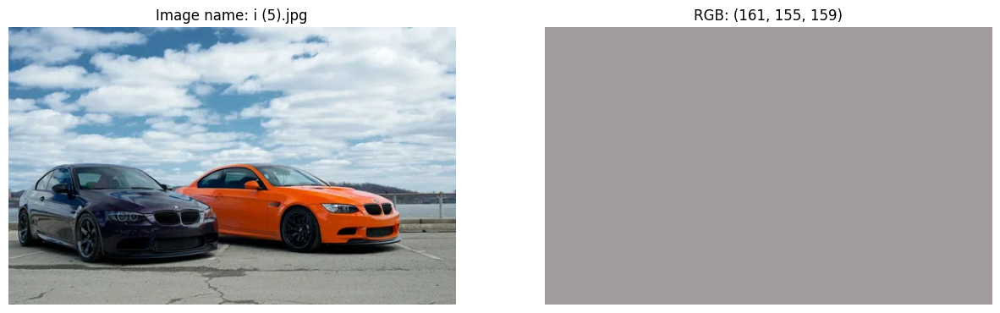

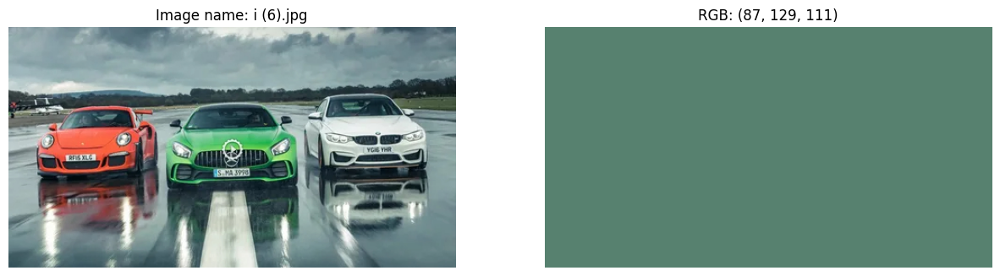

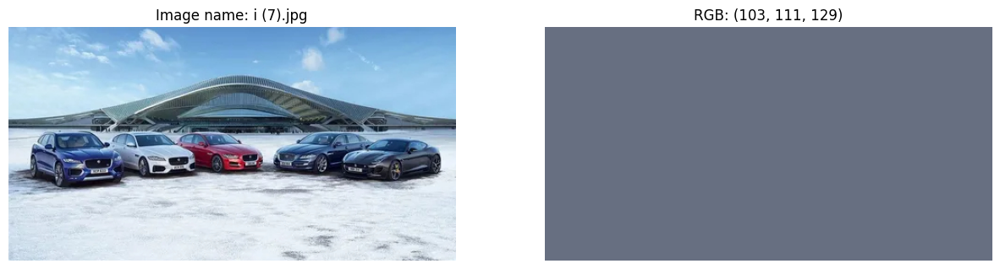

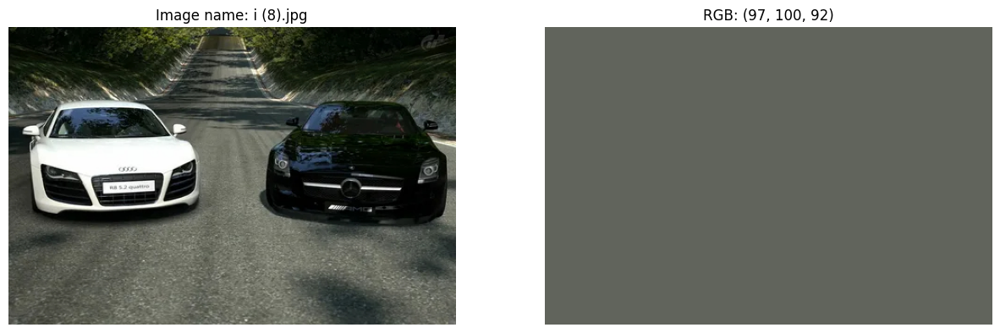

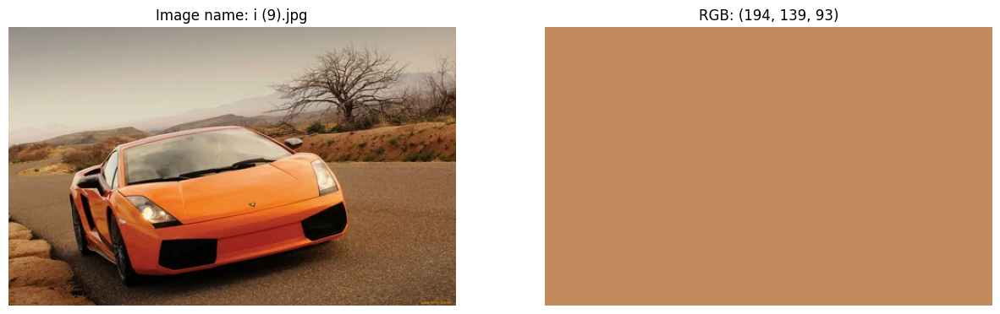

In [4]:
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    rgb_color = extract_car_colors_v1(image_path)
    display_images(image_path, [rgb_color])

Достаточно наглядно видно, что алгоритм вообще не справляется с ситуацией когда машин несколько или их нет вообще. Когда на фото одна большая машина, то алгоритм выдает цвет, очень отдаленно похожий на требуемый.

Необходимо усовершенствовать программу.

## Подход к решению №2

В предыдущем решении мы никак не учитывали количество автомобилей на фото, а также их расположение. Попробуем это исправить.

Будем использовать предобученную модель машинного обучения для детектирования обьектов. Хорошо себя зарекомендовала модель Yolo из библиотеки ultralytics.

Импортируем необходимые дополнительные библиотеки

In [5]:
from ultralytics import YOLO

Напишем функцию, которая будет детектировать автомобили на изображении с использованием модели yolo8n. Она будет принимать на вход адрес картинки и модель, а возвращать список координат (левая нижняя точка, ширина и высота)

In [6]:
def detect_cars(image_path: str, model):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = model(image)
    boxes = []
    for result in results:
        for box in result.boxes:
            class_id = int(box.cls)
            if class_id == 2:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                x1 = max(0, x1)
                y1 = max(0, y1)
                x2 = min(image.shape[1], x2)
                y2 = min(image.shape[0], y2)
                w = x2 - x1
                h = y2 - y1
                if w > 0 and h > 0:
                    boxes.append([x1, y1, w, h])

    return boxes

Теперь нашипем новую версию функции extract_car_colors. Она будет принимать на вход картинку и список координат прямоугольников. Возвращать будет средний цвет внутри каждого прямоугольника, полученного с помощью detect_cars


In [7]:
def extract_car_colors_v2(image_path: str, boxes: list) -> list:
    if boxes == []:
        return boxes
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    average_colors = []
    for box in boxes:
        x, y, w, h = box
        car_image = image[y:y+h, x:x+w]
        avg_color = tuple(map(int, np.mean(car_image.reshape(-1, 3), axis=0)))
        average_colors.append(avg_color)
    return average_colors


А также доработаем нашу функцию display_images, чтобы она нам выводила результаты обнаружения обьектов

In [8]:
def display_images_v2(image_path: str, rgb_list: list, boxes: list):
    # Загрузка изображения
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Вывод результата при отсутвии автомобилей
    if boxes == []:
        file_name = os.path.basename(image_path)
        plt.imshow(img)
        plt.title(f"{file_name}")
        plt.axis('off')
        plt.show()
        print('На фотографии автомобилей не обнаружено')
        return

    # Создание изображений цветов
    img_size = img.shape
    rgb_images = []
    for rgb in rgb_list:
        rgb_images.append(create_image_from_rgb(rgb, img_size))

    # Создание изображения с прямоугольниками
    img_detection = img.copy()
    for box in boxes:
        x, y, w, h = box
        cv2.rectangle(img_detection, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Создание фигуры
    total_images = len(rgb_list) + 2
    file_name = os.path.basename(image_path)
    plt.figure(figsize=(15, 5))

    # Отображение исходного изображения
    plt.subplot(1, total_images, 1)
    plt.imshow(img)
    plt.title(f"{file_name}")
    plt.axis('off')

    # Отображение исходного изображения с детекцией
    plt.subplot(1, total_images, 2)
    plt.imshow(img_detection)
    plt.title(f"{file_name} detected")
    plt.axis('off')

    # Отображение изображений с заданными цветами
    for i, rgb_img in enumerate(rgb_images):
        plt.subplot(1, total_images, i + 3)
        plt.imshow(rgb_img)
        plt.title(f"RGB: {rgb_list[i]}")
        plt.axis('off')

    plt.show()

Применим функции к нашему тестовому датасету и посмотрим результаты


0: 480x640 2 cars, 79.6ms
Speed: 4.0ms preprocess, 79.6ms inference, 5.5ms postprocess per image at shape (1, 3, 480, 640)


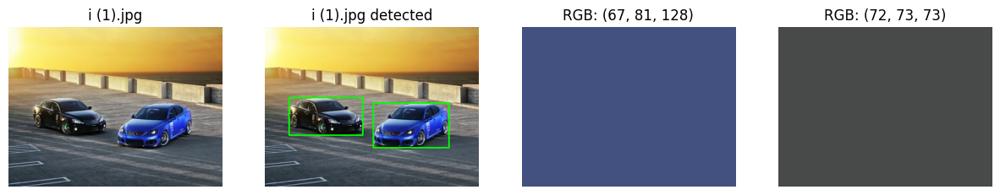


0: 448x640 (no detections), 49.5ms
Speed: 2.0ms preprocess, 49.5ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)


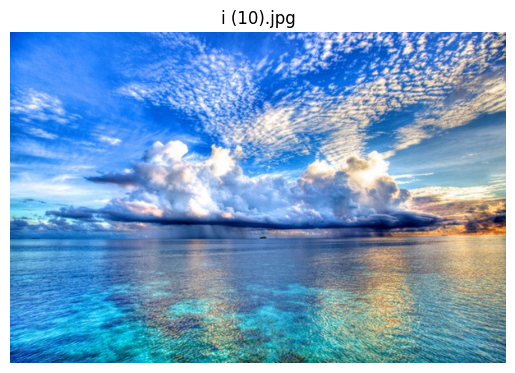

На фотографии автомобилей не обнаружено

0: 384x640 2 cars, 54.7ms
Speed: 2.0ms preprocess, 54.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


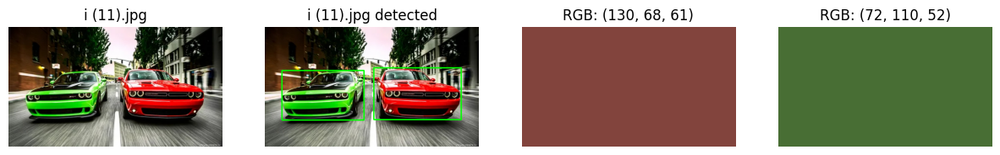


0: 416x640 2 cars, 51.5ms
Speed: 1.0ms preprocess, 51.5ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


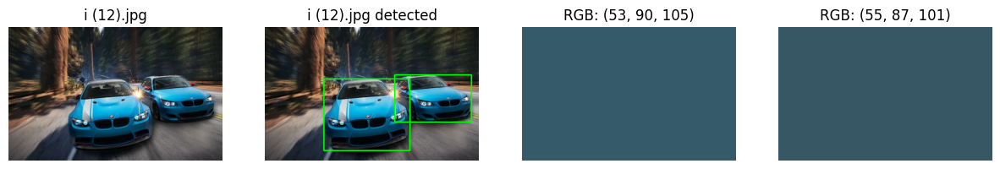


0: 384x640 1 car, 39.5ms
Speed: 1.0ms preprocess, 39.5ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


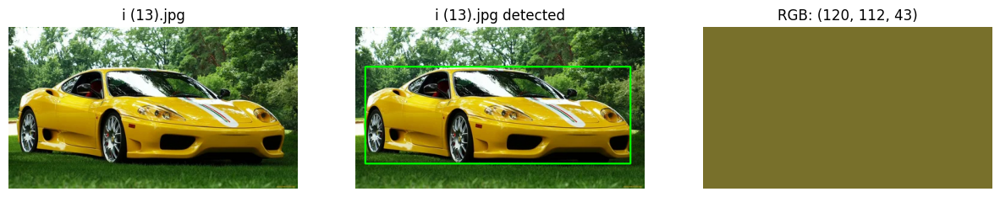


0: 416x640 1 car, 48.0ms
Speed: 3.0ms preprocess, 48.0ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


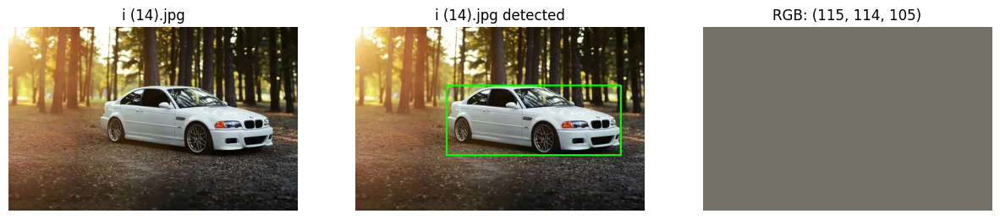


0: 384x640 1 car, 41.0ms
Speed: 1.0ms preprocess, 41.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


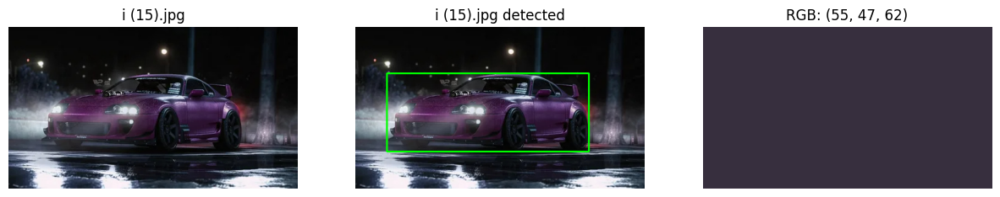


0: 384x640 2 cars, 40.9ms
Speed: 1.1ms preprocess, 40.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


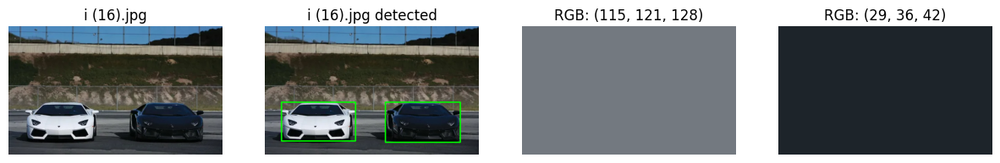


0: 384x640 3 cars, 37.0ms
Speed: 1.1ms preprocess, 37.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


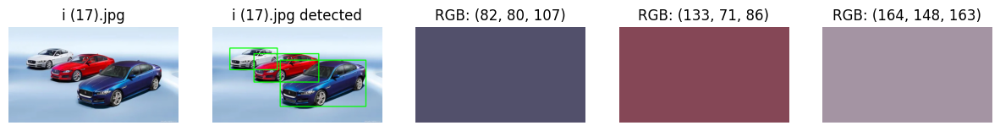


0: 480x640 4 cars, 44.5ms
Speed: 1.0ms preprocess, 44.5ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


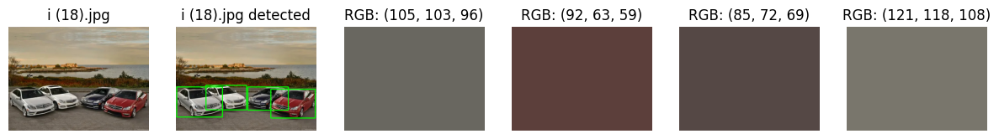


0: 384x640 1 car, 38.0ms
Speed: 1.0ms preprocess, 38.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


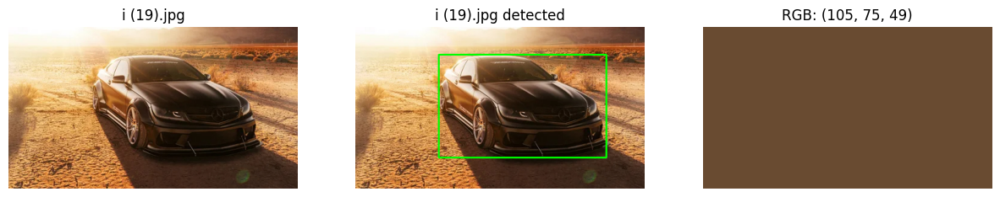


0: 384x640 1 dog, 39.5ms
Speed: 2.0ms preprocess, 39.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


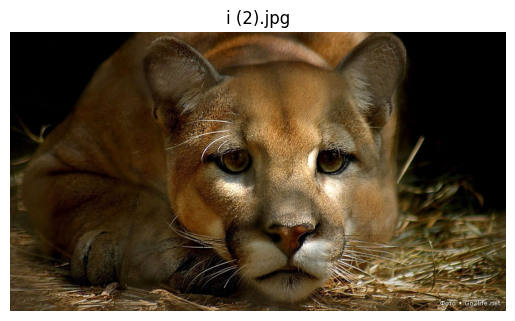

На фотографии автомобилей не обнаружено

0: 480x640 (no detections), 43.0ms
Speed: 2.0ms preprocess, 43.0ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


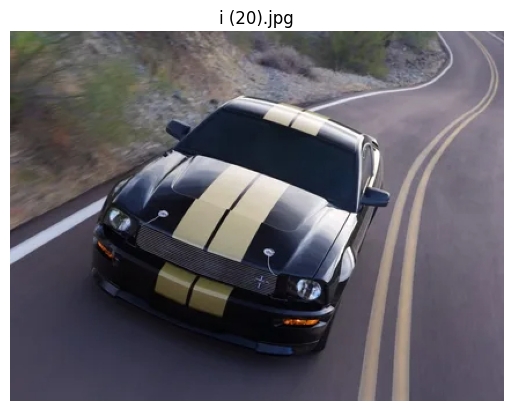

На фотографии автомобилей не обнаружено

0: 384x640 1 car, 39.0ms
Speed: 2.0ms preprocess, 39.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


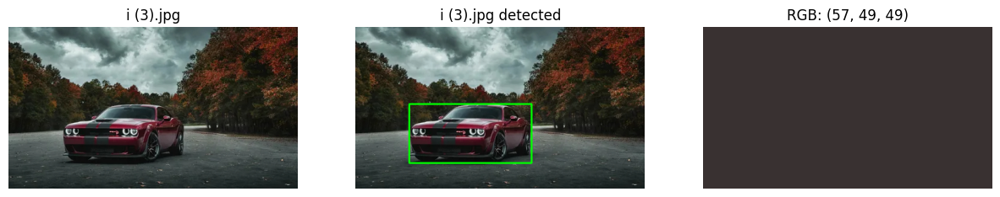


0: 416x640 2 cars, 58.6ms
Speed: 1.0ms preprocess, 58.6ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


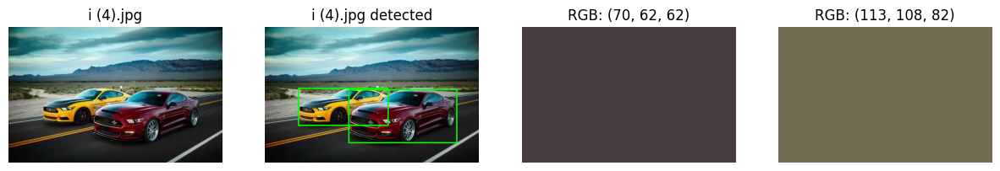


0: 416x640 2 cars, 39.5ms
Speed: 1.9ms preprocess, 39.5ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


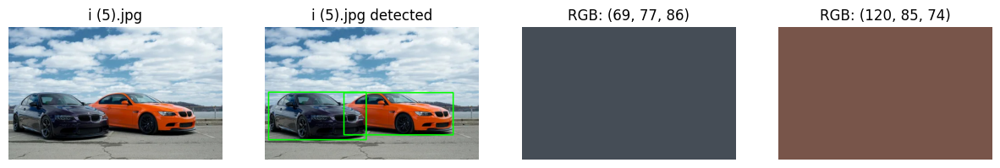


0: 352x640 3 cars, 1 truck, 45.5ms
Speed: 2.0ms preprocess, 45.5ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


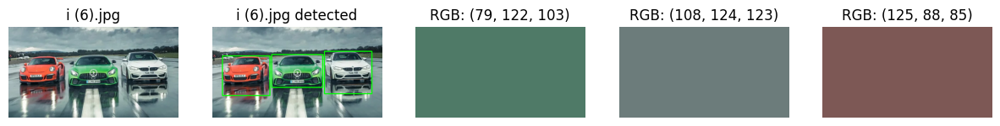


0: 352x640 5 cars, 37.5ms
Speed: 1.0ms preprocess, 37.5ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


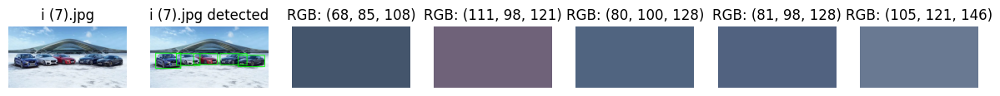


0: 448x640 2 cars, 48.0ms
Speed: 2.0ms preprocess, 48.0ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


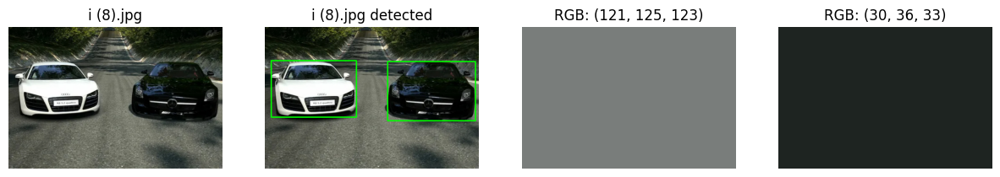


0: 416x640 1 car, 39.5ms
Speed: 1.0ms preprocess, 39.5ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


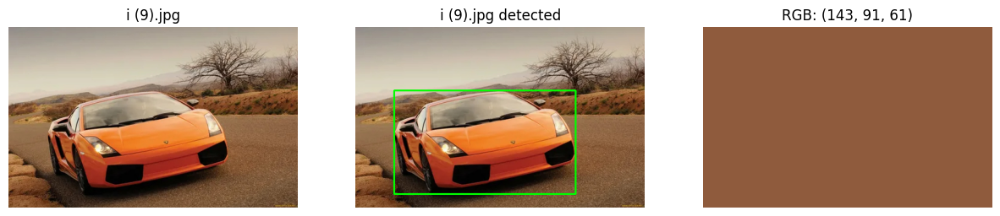

In [9]:
# Создадим модель
model = YOLO('yolov8n.pt')
# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes = detect_cars(image_path, model)
    rgb_color = extract_car_colors_v2(image_path, boxes)
    display_images_v2(image_path, rgb_color, boxes)

Одну машину детектировать не удалось, а также цвета отображаются в произвольном порядке. Попробуем предобученную модель побольше, а также отсортируем результаты слева направо.


0: 480x640 2 cars, 553.2ms
Speed: 2.0ms preprocess, 553.2ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)


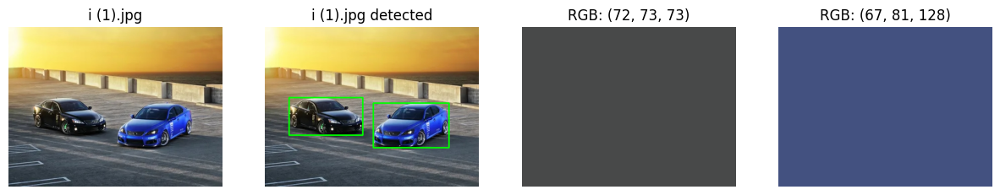


0: 448x640 (no detections), 498.7ms
Speed: 2.0ms preprocess, 498.7ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)


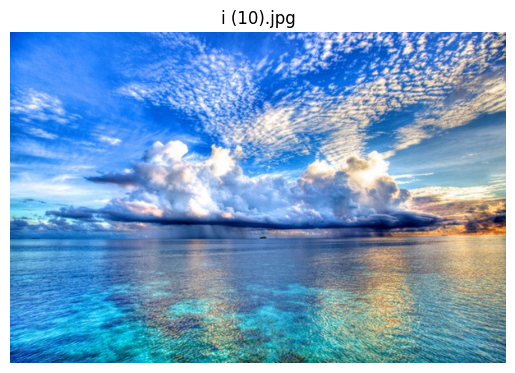

На фотографии автомобилей не обнаружено

0: 384x640 1 person, 2 cars, 428.2ms
Speed: 1.0ms preprocess, 428.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


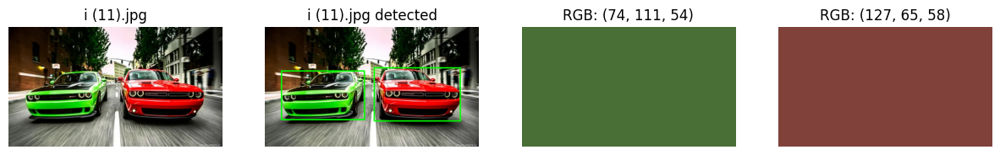


0: 416x640 2 cars, 461.3ms
Speed: 1.0ms preprocess, 461.3ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


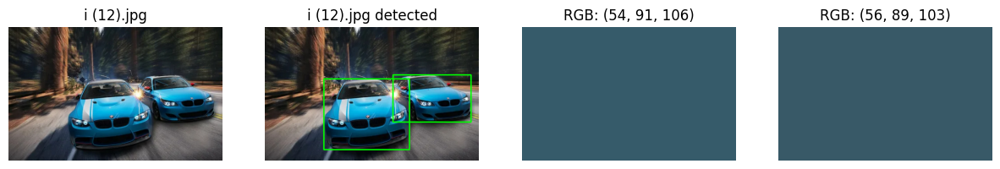


0: 384x640 1 car, 434.5ms
Speed: 1.0ms preprocess, 434.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


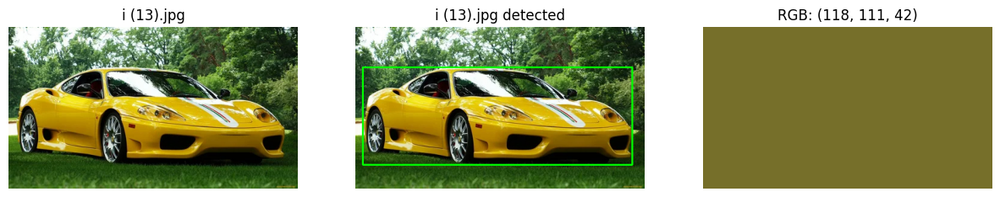


0: 416x640 1 car, 452.6ms
Speed: 1.0ms preprocess, 452.6ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


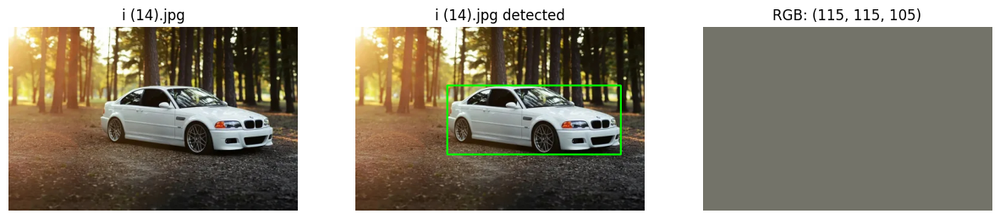


0: 384x640 1 car, 436.8ms
Speed: 1.0ms preprocess, 436.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


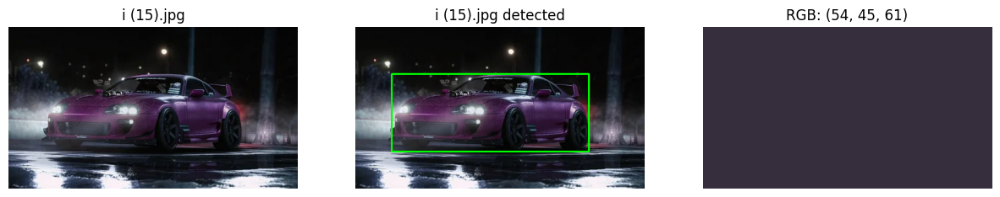


0: 384x640 2 cars, 465.3ms
Speed: 2.2ms preprocess, 465.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


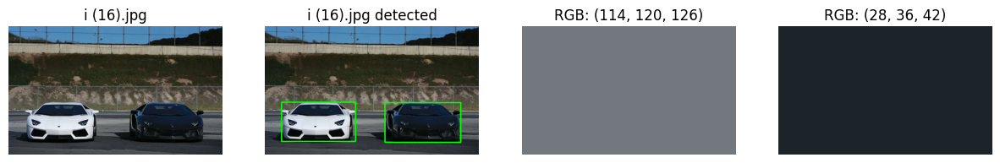


0: 384x640 3 cars, 426.2ms
Speed: 1.1ms preprocess, 426.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


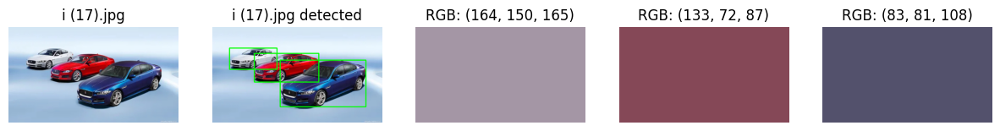


0: 480x640 4 cars, 510.1ms
Speed: 2.0ms preprocess, 510.1ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)


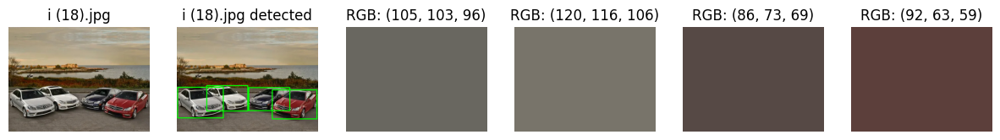


0: 384x640 1 car, 421.5ms
Speed: 1.0ms preprocess, 421.5ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


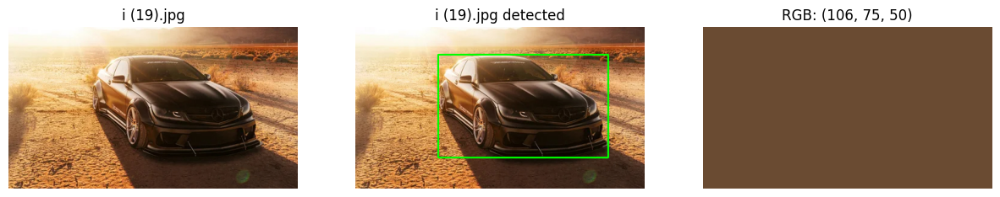


0: 384x640 1 dog, 418.9ms
Speed: 2.0ms preprocess, 418.9ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


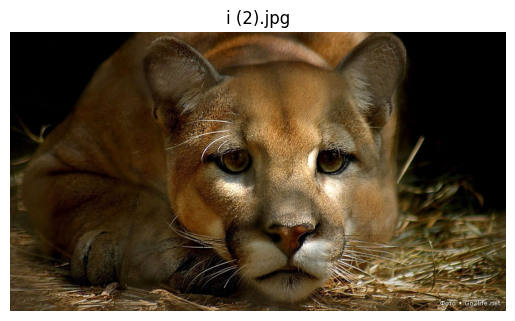

На фотографии автомобилей не обнаружено

0: 480x640 1 car, 514.1ms
Speed: 1.0ms preprocess, 514.1ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)


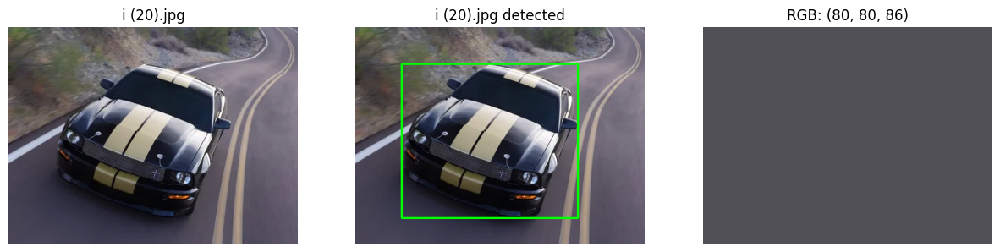


0: 384x640 1 car, 438.8ms
Speed: 2.0ms preprocess, 438.8ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


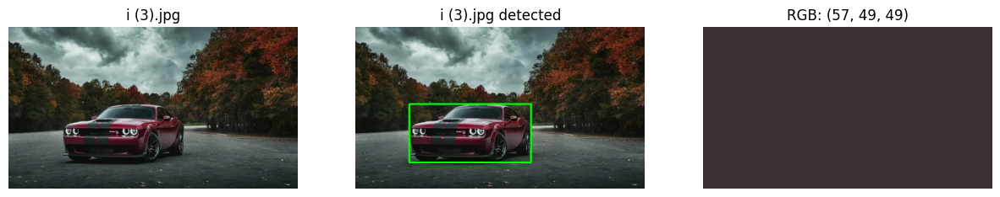


0: 416x640 2 cars, 452.1ms
Speed: 1.0ms preprocess, 452.1ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 640)


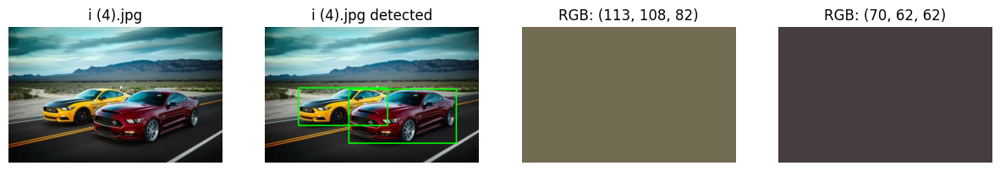


0: 416x640 2 cars, 453.2ms
Speed: 2.0ms preprocess, 453.2ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


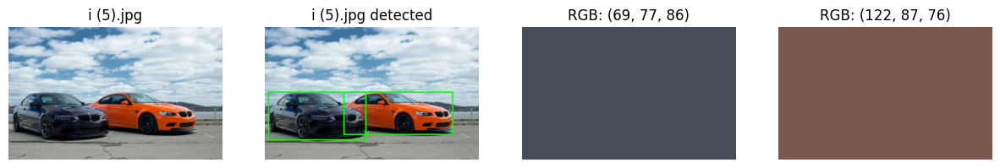


0: 352x640 1 person, 3 cars, 395.9ms
Speed: 1.0ms preprocess, 395.9ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


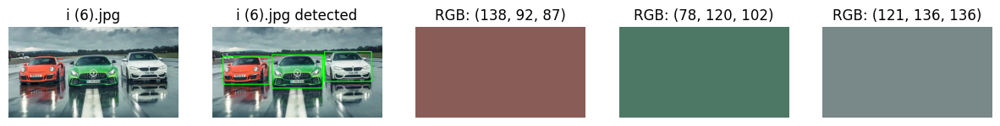


0: 352x640 5 cars, 383.2ms
Speed: 1.0ms preprocess, 383.2ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


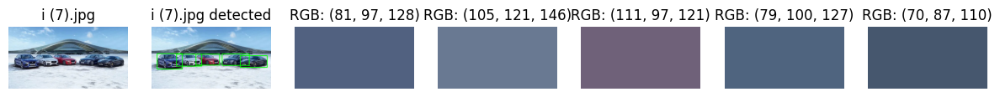


0: 448x640 1 person, 2 cars, 481.4ms
Speed: 2.0ms preprocess, 481.4ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


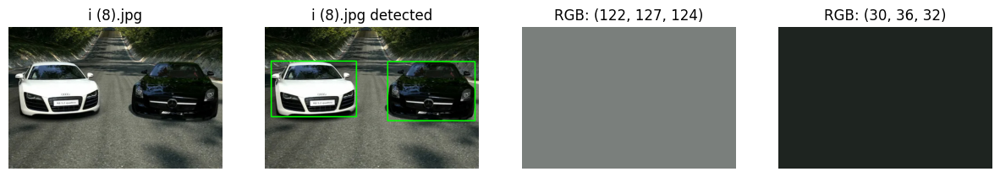


0: 416x640 1 car, 448.5ms
Speed: 1.0ms preprocess, 448.5ms inference, 0.5ms postprocess per image at shape (1, 3, 416, 640)


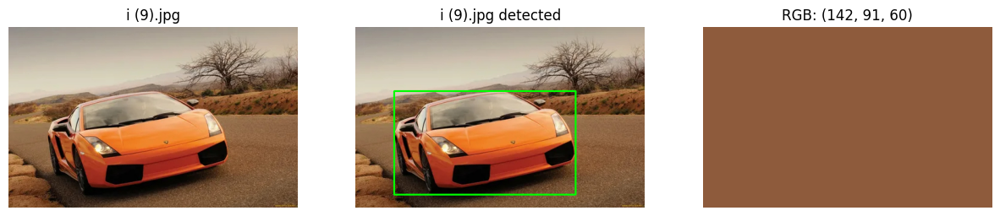

In [10]:
def detect_cars(image_path: str, model):
    # Загрузка изображения по пути
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Выполнение инференса модели
    results = model(image)
    boxes = []
    # Получение результата
    for result in results:
        for box in result.boxes:
            class_id = int(box.cls)
            if class_id == 2:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                x1 = max(0, x1)
                y1 = max(0, y1)
                x2 = min(image.shape[1], x2)
                y2 = min(image.shape[0], y2)
                w = x2 - x1
                h = y2 - y1
                if w > 0 and h > 0:
                    boxes.append([x1, y1, w, h])
    # Сортировка по координате x1 (слева направо)
    boxes = sorted(boxes, key=lambda b: b[0])
    return boxes


# Создадим модель
model = YOLO('yolov8x.pt')
# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes = detect_cars(image_path, model)
    rgb_color = extract_car_colors_v2(image_path, boxes)
    display_images_v2(image_path, rgb_color, boxes)

Нам удалось улучшить результат, но цвета всеравно далеки от идеала. Скорее всего это связано с тем, что в прямоугольник попадает не только автомобиль, а также сам автомобиль имеет множество элементов другого цвета.


## Подход к решению №3

В предыдущем варианте решения удалось детектировать все автомобили и для кажного из них получить свой цвет. Попробуем улучшить точность извлечения цвета. 

Можно попробовать более точно определить местоположение автомобиля и уменьшить количество пикселей с неправильными цветами. Или можно попробовать применить кластеризацию. С ее помощью мы сможем выделим несколько групп цветов, усредняя значения только внутри группы. Вероятнее всего самая большая группа и будет цветом нашего автомобиля.

Выберем вариант с кластеризацией. Напишем новую версию функции extract_car_colors. Пременим Kmeans из библиотеки scikit-learn 

In [11]:
from sklearn.cluster import KMeans

In [12]:
def extract_car_colors_v3(image_path: str, boxes: list, k: int = 5) -> list:
    if not boxes:
        return boxes

    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    dominant_colors = []

    for box in boxes:
        x, y, w, h = box
        car_image = image[y:y+h, x:x+w]
        car_image_reshaped = car_image.reshape((-1, 3))

        # Применяем кластеризацию K-means для нахождения доминирующего цвета
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(car_image_reshaped)
        cluster_centers = kmeans.cluster_centers_

        # Находим самый большой кластер
        labels, counts = np.unique(kmeans.labels_, return_counts=True)
        dominant_color_index = labels[np.argmax(counts)]
        dominant_color = tuple(map(int, cluster_centers[dominant_color_index]))

        dominant_colors.append(dominant_color)

    return dominant_colors

Посмотрим на результат


0: 480x640 2 cars, 517.5ms
Speed: 1.0ms preprocess, 517.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


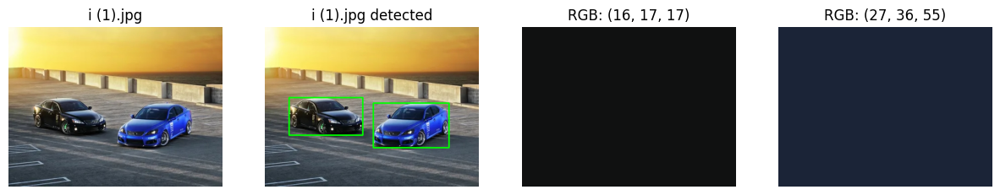


0: 448x640 (no detections), 482.0ms
Speed: 1.5ms preprocess, 482.0ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


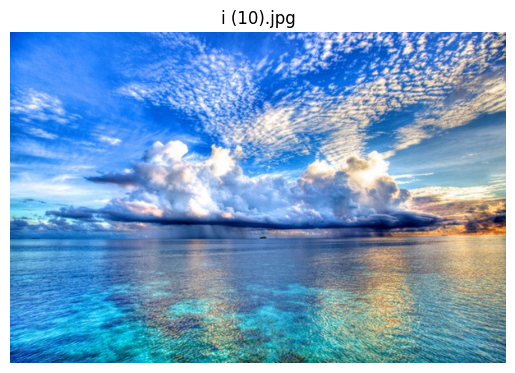

На фотографии автомобилей не обнаружено

0: 384x640 1 person, 2 cars, 422.4ms
Speed: 1.0ms preprocess, 422.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


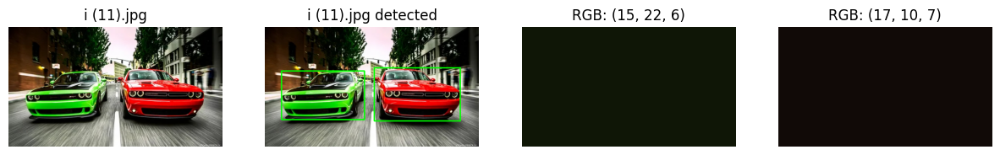


0: 416x640 2 cars, 446.1ms
Speed: 1.0ms preprocess, 446.1ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


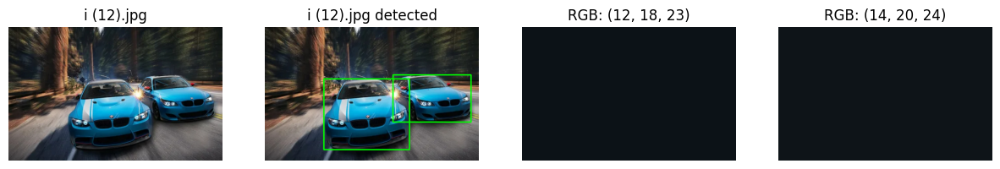


0: 384x640 1 car, 422.0ms
Speed: 2.0ms preprocess, 422.0ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


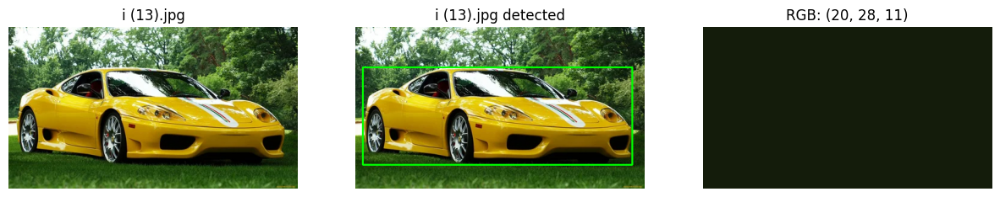


0: 416x640 1 car, 450.6ms
Speed: 1.6ms preprocess, 450.6ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


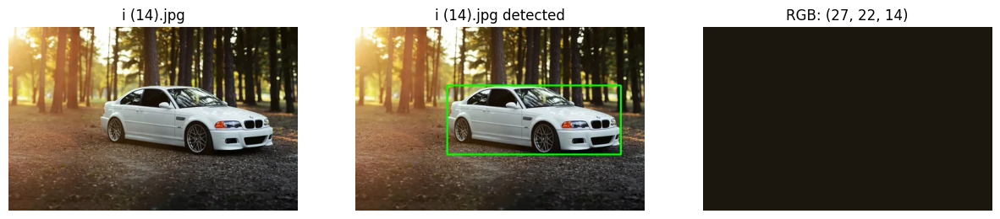


0: 384x640 1 car, 419.6ms
Speed: 1.0ms preprocess, 419.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


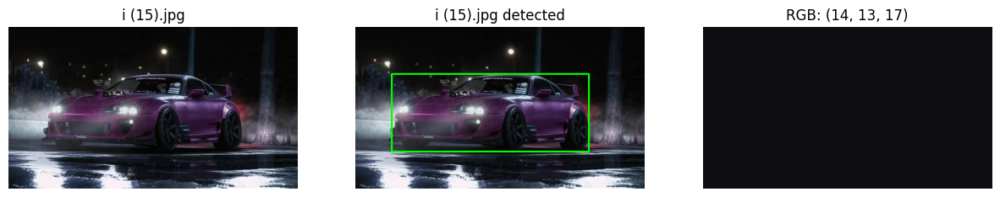


0: 384x640 2 cars, 419.8ms
Speed: 1.0ms preprocess, 419.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


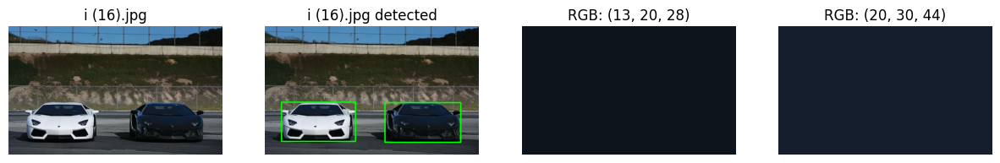


0: 384x640 3 cars, 416.3ms
Speed: 2.0ms preprocess, 416.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


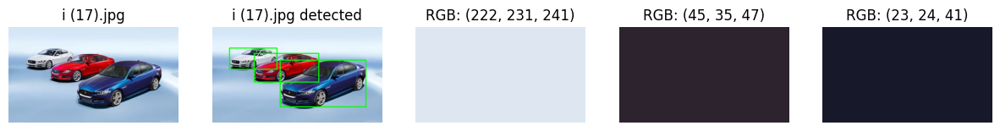


0: 480x640 4 cars, 517.8ms
Speed: 1.0ms preprocess, 517.8ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)


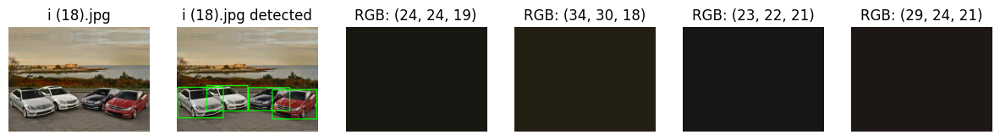


0: 384x640 1 car, 419.1ms
Speed: 2.0ms preprocess, 419.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


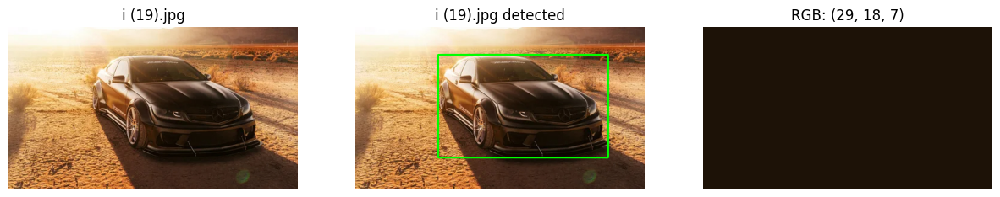


0: 384x640 1 dog, 414.9ms
Speed: 1.0ms preprocess, 414.9ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


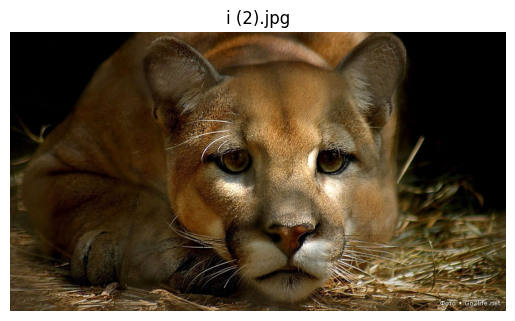

На фотографии автомобилей не обнаружено

0: 480x640 1 car, 517.0ms
Speed: 2.0ms preprocess, 517.0ms inference, 0.0ms postprocess per image at shape (1, 3, 480, 640)


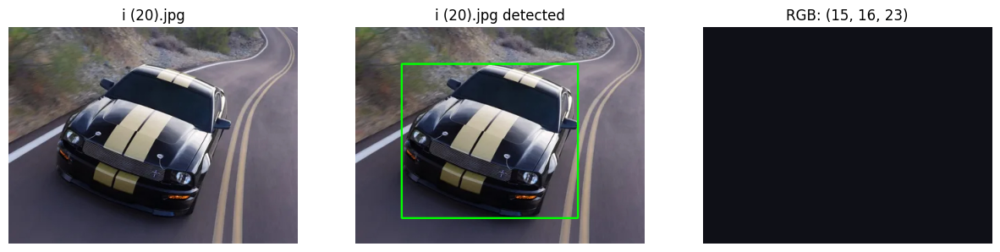


0: 384x640 1 car, 417.5ms
Speed: 1.0ms preprocess, 417.5ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


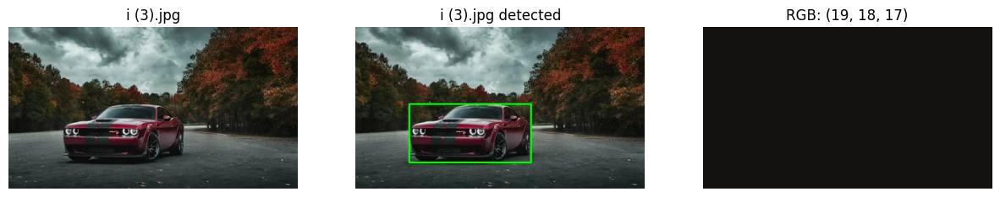


0: 416x640 2 cars, 470.1ms
Speed: 2.0ms preprocess, 470.1ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


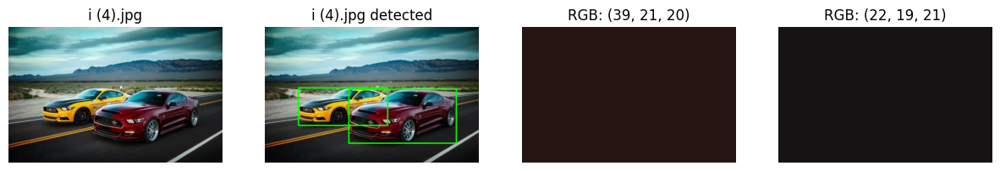


0: 416x640 2 cars, 452.9ms
Speed: 1.0ms preprocess, 452.9ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


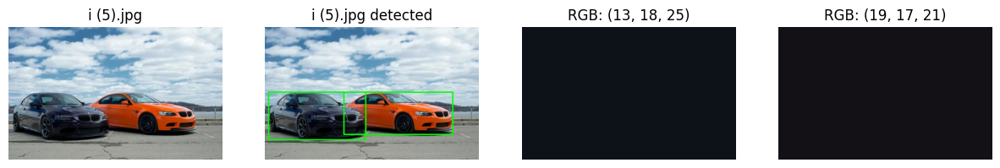


0: 352x640 1 person, 3 cars, 381.8ms
Speed: 1.0ms preprocess, 381.8ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


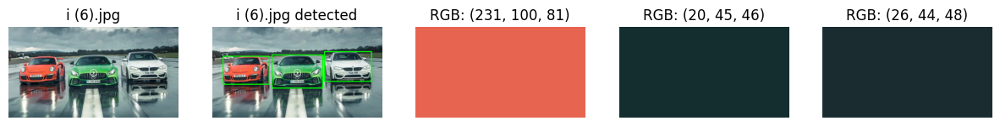


0: 352x640 5 cars, 386.6ms
Speed: 1.0ms preprocess, 386.6ms inference, 0.0ms postprocess per image at shape (1, 3, 352, 640)


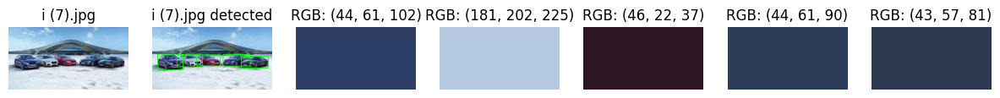


0: 448x640 1 person, 2 cars, 493.9ms
Speed: 2.0ms preprocess, 493.9ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


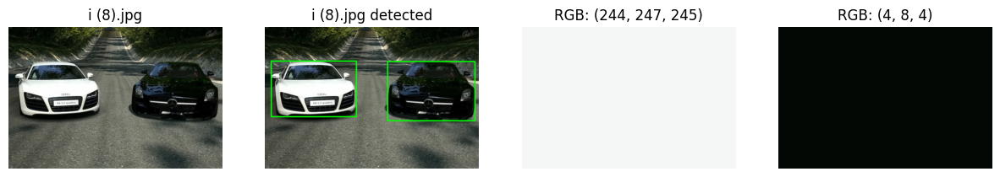


0: 416x640 1 car, 448.1ms
Speed: 1.6ms preprocess, 448.1ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


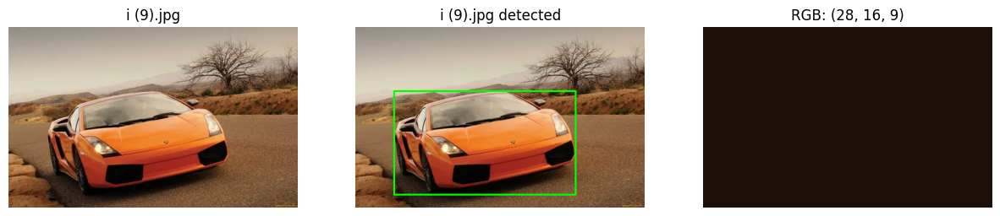

In [13]:
# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes = detect_cars(image_path, model)
    rgb_color = extract_car_colors_v3(image_path, boxes, k=5)
    display_images_v2(image_path, rgb_color, boxes)

Попробовал различное количество кластеров складывается ощущение что доминирующий цвет оказывается черный, а не цвет автомобиля, посмотрим на все кластеры.


0: 480x640 2 cars, 515.5ms
Speed: 2.0ms preprocess, 515.5ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


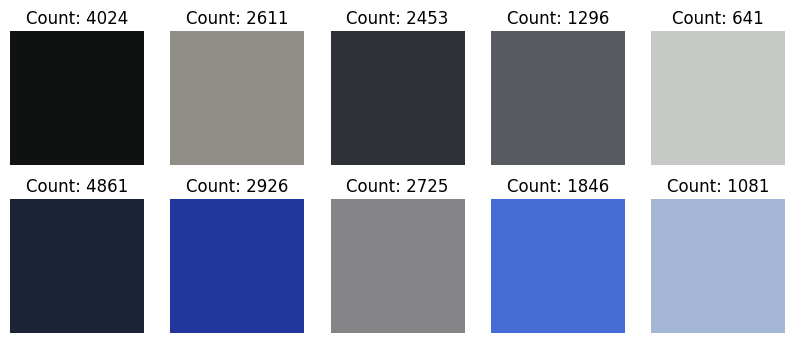

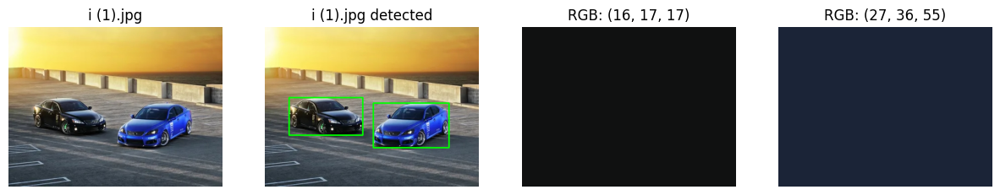


0: 448x640 (no detections), 489.5ms
Speed: 1.0ms preprocess, 489.5ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)


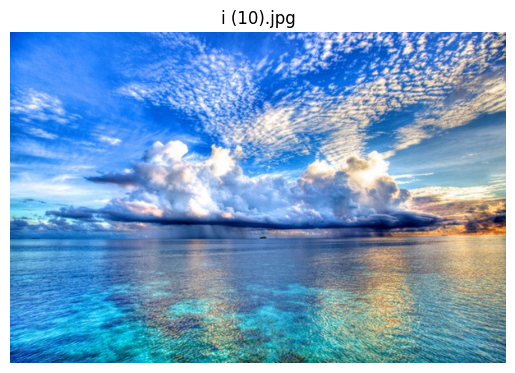

На фотографии автомобилей не обнаружено

0: 384x640 1 person, 2 cars, 417.8ms
Speed: 1.0ms preprocess, 417.8ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


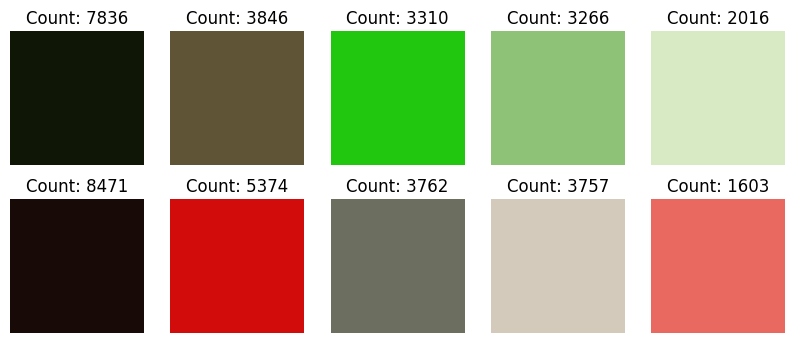

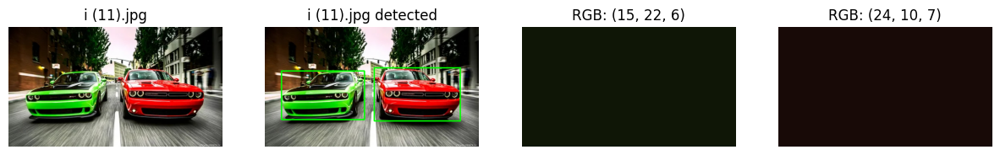


0: 416x640 2 cars, 448.8ms
Speed: 1.0ms preprocess, 448.8ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


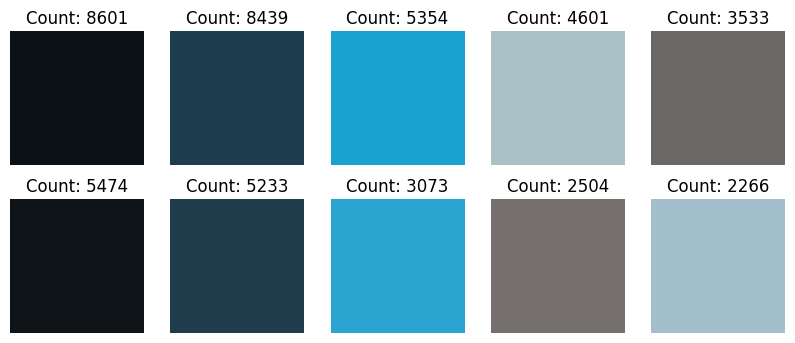

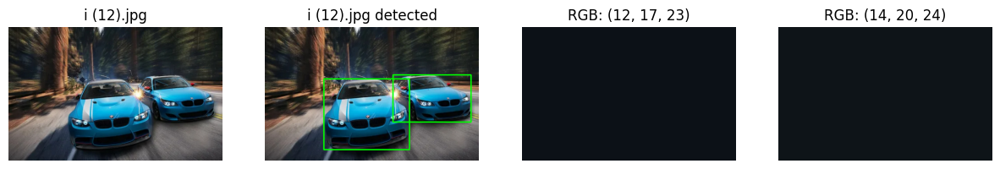


0: 384x640 1 car, 419.8ms
Speed: 1.6ms preprocess, 419.8ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


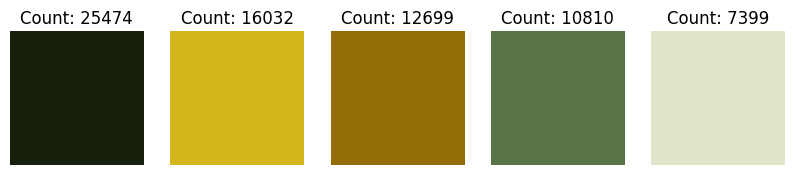

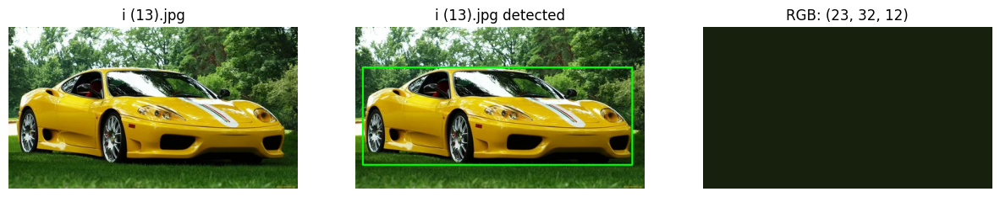


0: 416x640 1 car, 451.2ms
Speed: 2.0ms preprocess, 451.2ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


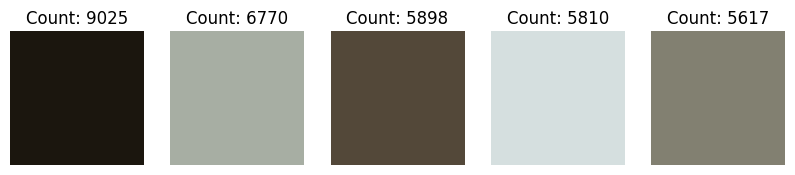

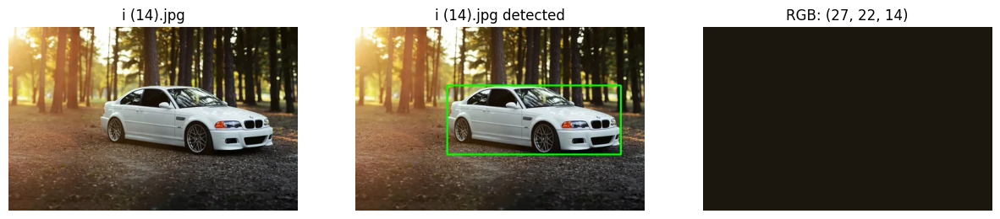


0: 384x640 1 car, 433.9ms
Speed: 1.0ms preprocess, 433.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


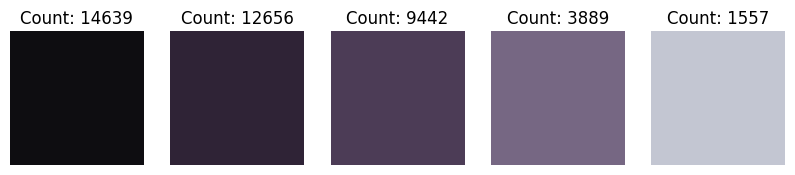

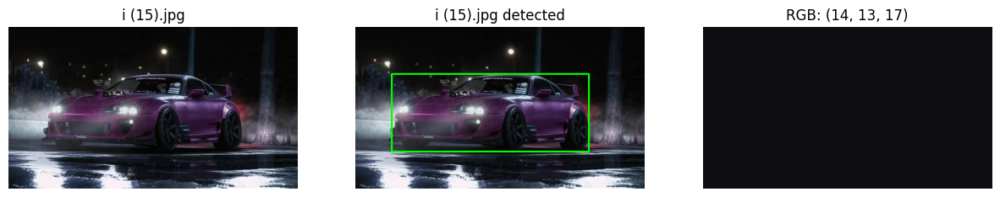


0: 384x640 2 cars, 420.5ms
Speed: 1.1ms preprocess, 420.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


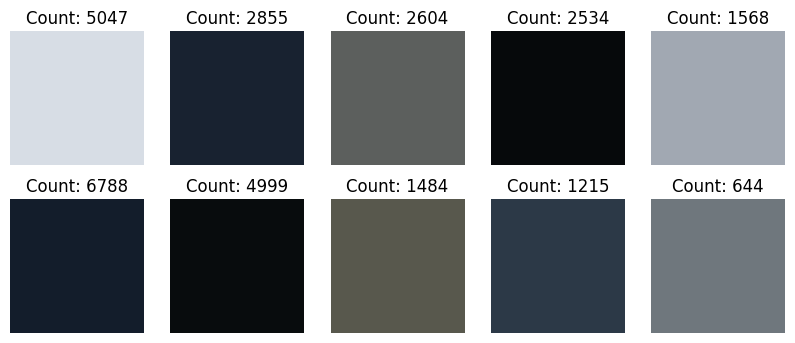

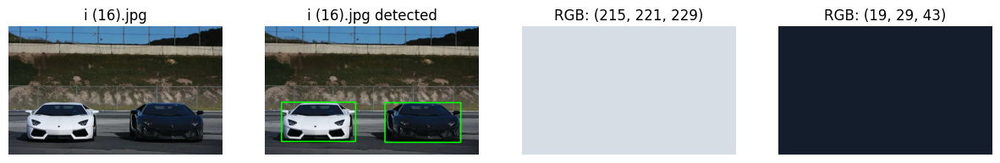


0: 384x640 3 cars, 419.8ms
Speed: 1.0ms preprocess, 419.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


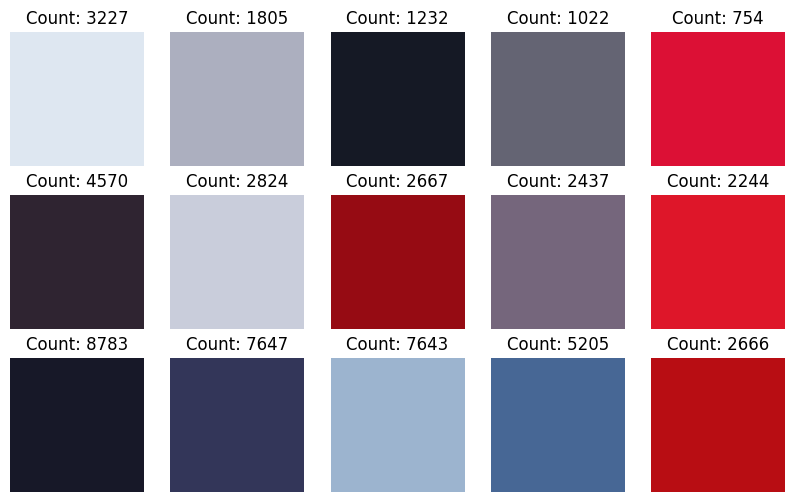

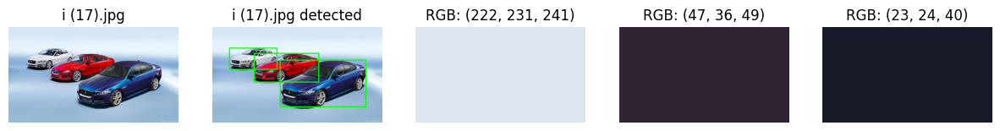


0: 480x640 4 cars, 523.7ms
Speed: 2.0ms preprocess, 523.7ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


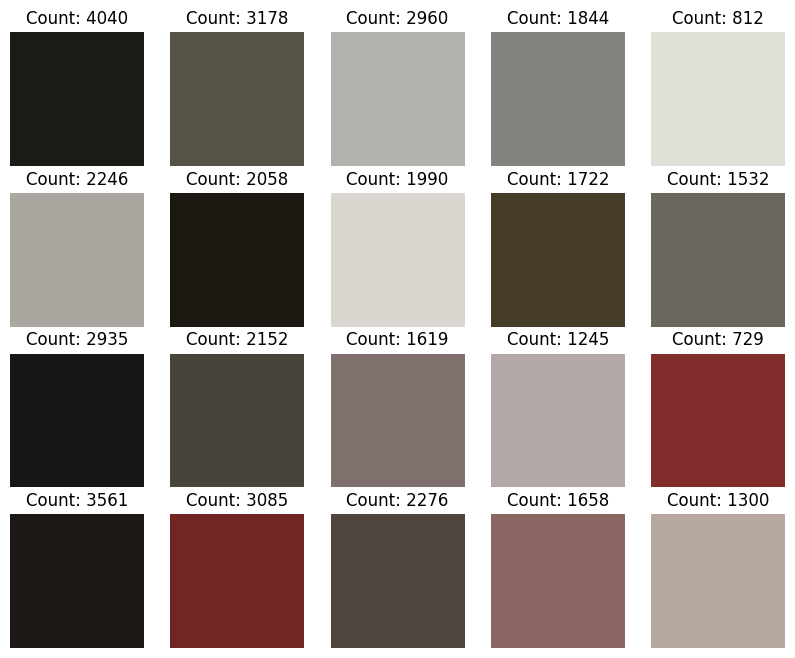

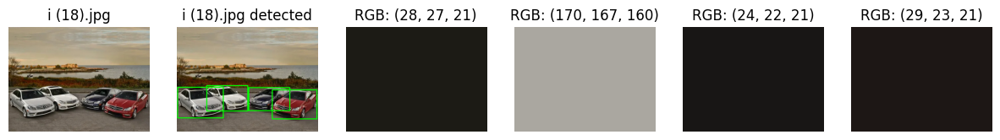


0: 384x640 1 car, 418.5ms
Speed: 1.0ms preprocess, 418.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


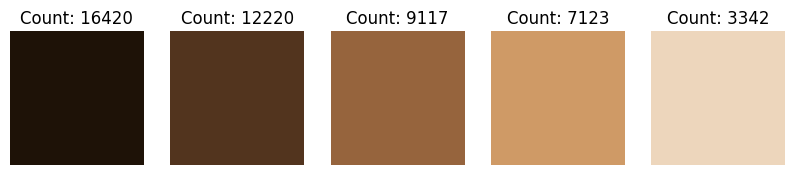

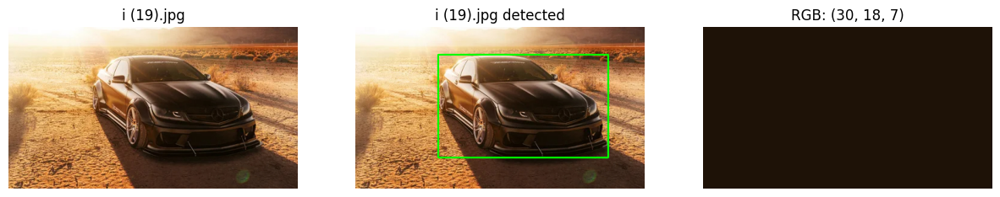


0: 384x640 1 dog, 420.9ms
Speed: 1.0ms preprocess, 420.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


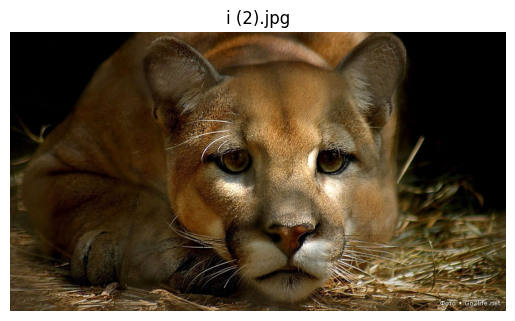

На фотографии автомобилей не обнаружено

0: 480x640 1 car, 509.1ms
Speed: 1.1ms preprocess, 509.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


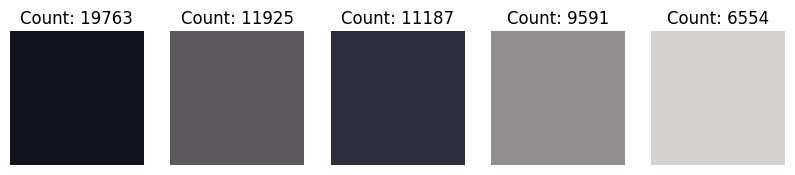

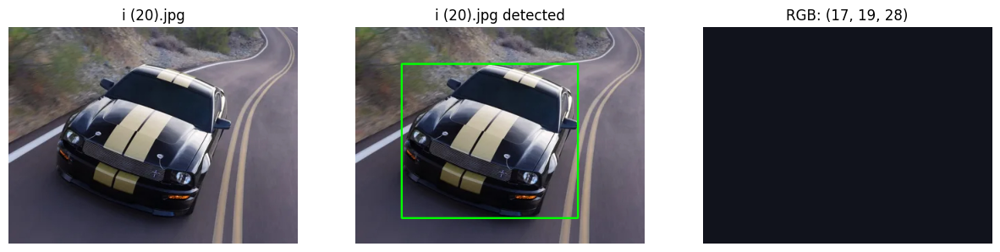


0: 384x640 1 car, 437.2ms
Speed: 1.0ms preprocess, 437.2ms inference, 0.0ms postprocess per image at shape (1, 3, 384, 640)


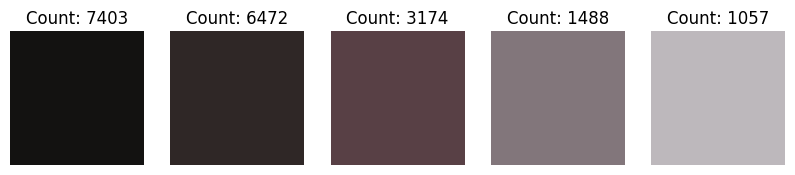

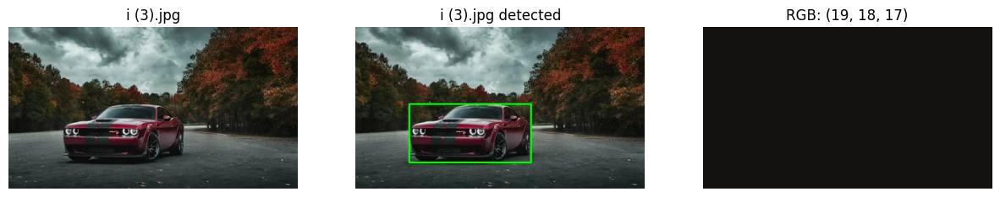


0: 416x640 2 cars, 458.8ms
Speed: 1.0ms preprocess, 458.8ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


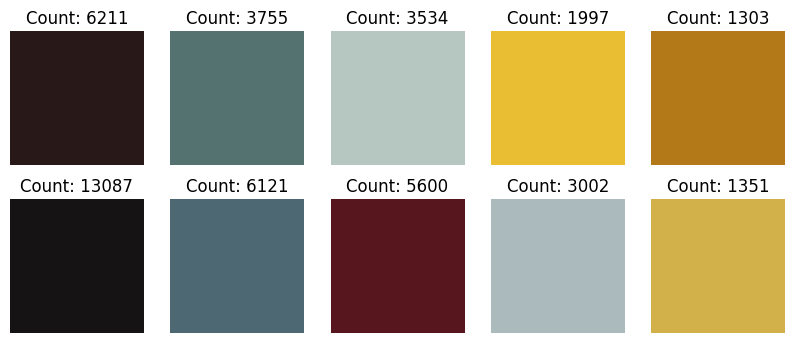

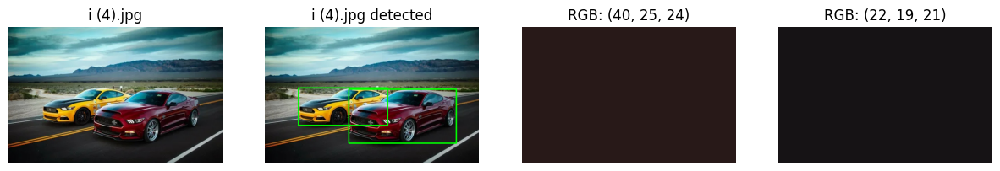


0: 416x640 2 cars, 451.1ms
Speed: 1.0ms preprocess, 451.1ms inference, 0.0ms postprocess per image at shape (1, 3, 416, 640)


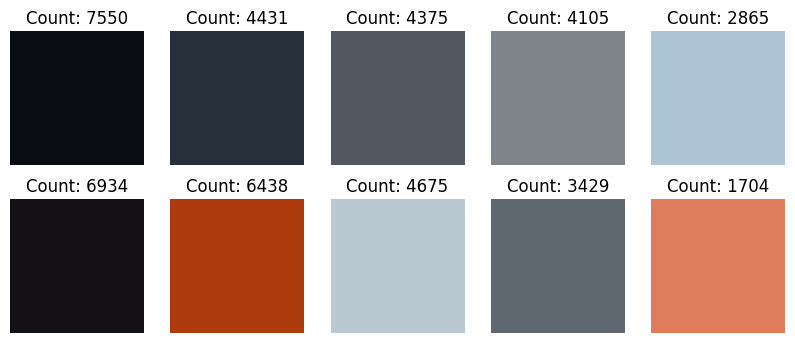

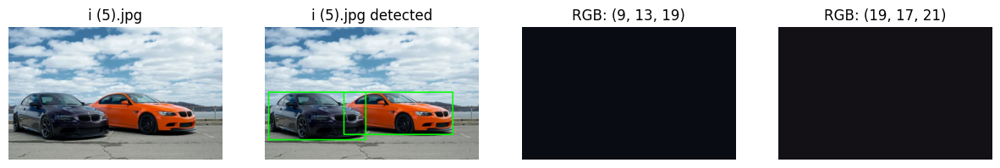


0: 352x640 1 person, 3 cars, 377.9ms
Speed: 1.0ms preprocess, 377.9ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


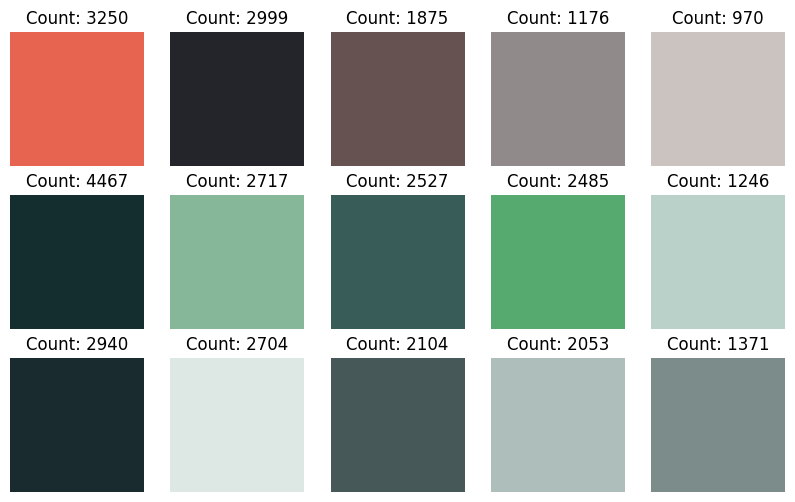

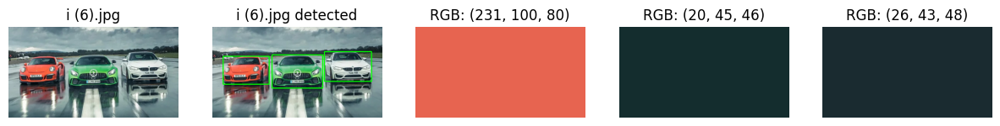


0: 352x640 5 cars, 378.4ms
Speed: 1.0ms preprocess, 378.4ms inference, 1.0ms postprocess per image at shape (1, 3, 352, 640)


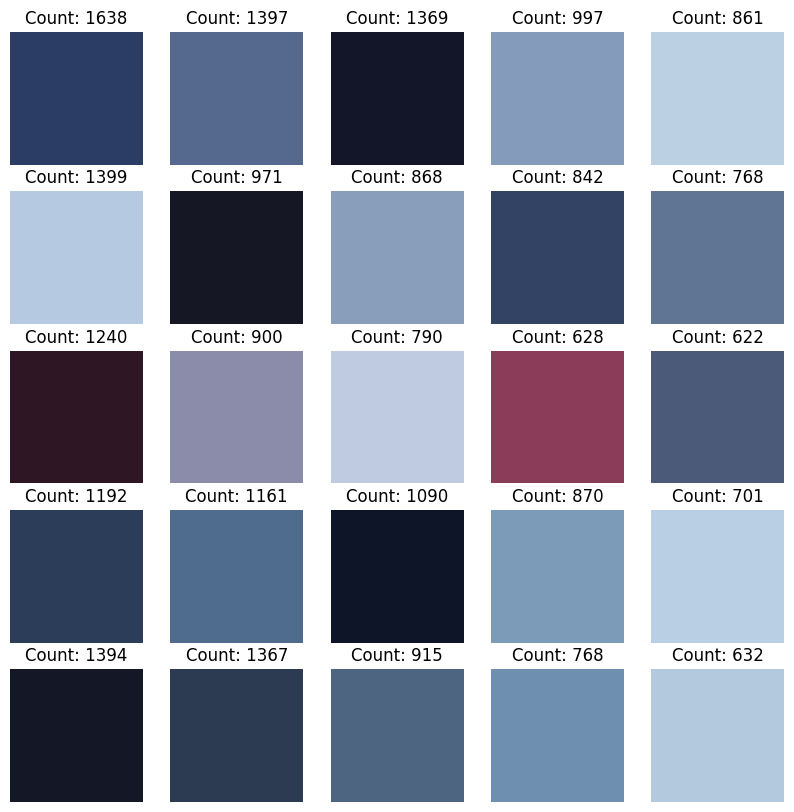

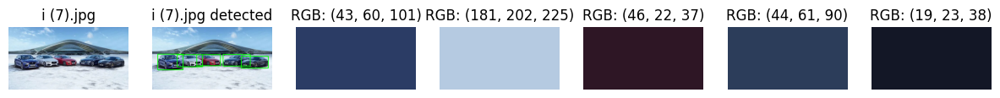


0: 448x640 1 person, 2 cars, 476.3ms
Speed: 1.0ms preprocess, 476.3ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


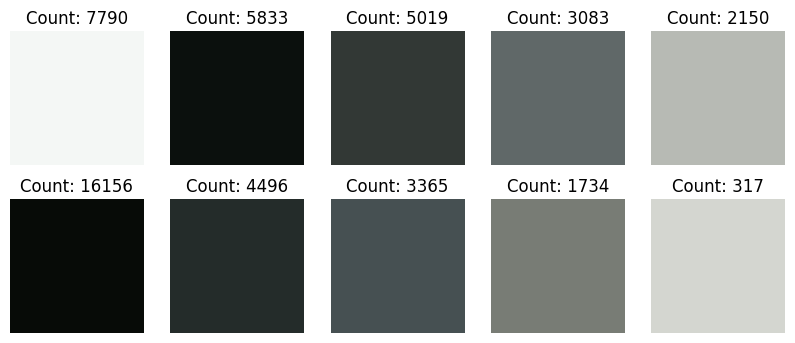

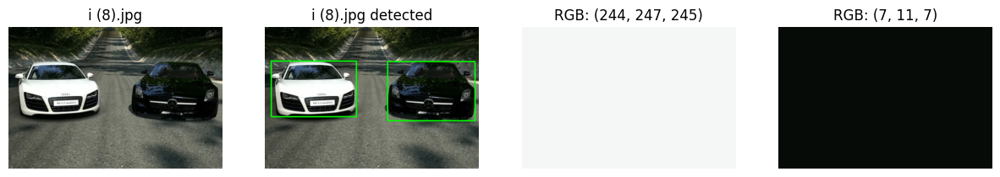


0: 416x640 1 car, 468.8ms
Speed: 1.0ms preprocess, 468.8ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


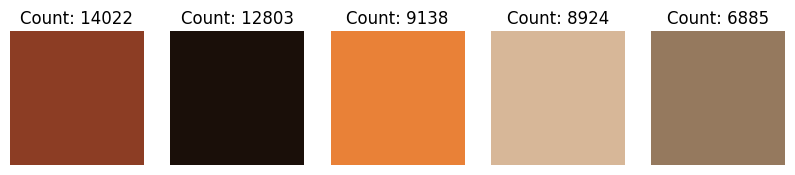

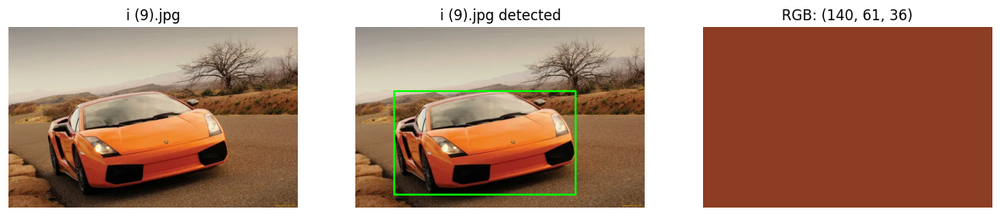

In [14]:
def extract_car_colors_v3_all(image_path: str, boxes: list, k: int = 3) -> list:
    if boxes == []:
        return boxes, boxes

    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    dominant_colors = []
    all_cluster_centers_counts = []

    for box in boxes:
        x, y, w, h = box
        car_image = image[y:y+h, x:x+w]
        car_image_reshaped = car_image.reshape((-1, 3))

        # Применяем кластеризацию K-means для нахождения доминирующих цветов
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(car_image_reshaped)
        cluster_centers = kmeans.cluster_centers_
        labels, counts = np.unique(kmeans.labels_, return_counts=True)

        # Сохраняем центры кластеров и количество элементов
        for center, count in sorted(zip(cluster_centers, counts), key=lambda x: -x[1]):
            all_cluster_centers_counts.append((center, count))

        # Находим самый большой кластер
        dominant_color_index = labels[np.argmax(counts)]
        dominant_color = tuple(map(int, cluster_centers[dominant_color_index]))
        dominant_colors.append(dominant_color)
    return dominant_colors, all_cluster_centers_counts

def visualize_clusters(cluster_centers_counts, picture_size=(100, 100), clusters_count=5):
    num_colors = len(cluster_centers_counts)
    if num_colors == 0:
        return
    num_rows = (num_colors + clusters_count - 1) // clusters_count

    fig, axes = plt.subplots(num_rows, clusters_count, figsize=(clusters_count * 2, num_rows * 2))

    for i, (center, count) in enumerate(cluster_centers_counts):
        row, col = divmod(i, clusters_count)
        ax = axes[row, col] if num_rows > 1 else axes[col]
        color_image = create_image_from_rgb(tuple(map(int, center)), [picture_size[0], picture_size[1], 3])
        ax.imshow(color_image)
        ax.set_title(f"Count: {count}")
        ax.axis('off')

    plt.show()


# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes = detect_cars(image_path, model)
    clusters_count = 5
    rgb_color, all_cluster_centers_counts  = extract_car_colors_v3_all(image_path, boxes, k=clusters_count)
    visualize_clusters(all_cluster_centers_counts, clusters_count=clusters_count)
    display_images_v2(image_path, rgb_color, boxes)

С применением кластеризации качество извлекаемого цвета улучшилось. Требуемый цвет присутствует в палитре кластеров. Некоторые фотографии обрабатывает отлично, а некоторые вообще неправильно. Это связано с доминацией черного цвета, а также присутствием фона на картинке.

## Подход к решению №4

Попробуем выполнить сегментацию изображения, т.е выделить автомобили более четко, чтобы уменьшить количетсво лишних точек. Будем использовать расширенную модель yolo. Также попробуем использовать медиану вместо среднего

Добавим в нашу функцию detect_cars распознавание масок

In [15]:
def detect_cars_with_segmentation(image_path: str, model):
    # Загрузка изображения по пути
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Выполнение инференса модели
    results = model(image)
    boxes = []
    masks = []

    # Получение результата
    for result in results:
        for i, box in enumerate(result.boxes):
            class_id = int(box.cls)
            if class_id == 2:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                x1 = max(0, x1)
                y1 = max(0, y1)
                x2 = min(image.shape[1], x2)
                y2 = min(image.shape[0], y2)
                w = x2 - x1
                h = y2 - y1
                if w > 0 and h > 0:
                    boxes.append([x1, y1, w, h])
                    masks.append(result.masks.data[i].cpu().numpy())
    if boxes == [] or masks == []:
        return [], []
    # Сортировка боксов и масок по координате x1 (слева направо)
    sorted_boxes_masks = sorted(zip(boxes, masks), key=lambda bm: bm[0][0])
    boxes, masks = zip(*sorted_boxes_masks)

    return list(boxes), list(masks)


Переработаем функцию отображение результатов с добавлением масок

In [16]:
def display_images_v3(image_path: str, rgb_list: list, boxes: list, masks: list):
    # Загрузка изображения
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Вывод результата при отсутствии автомобилей
    if not boxes:
        file_name = os.path.basename(image_path)
        plt.imshow(img)
        plt.title(f"{file_name}")
        plt.axis('off')
        plt.show()
        print('На фотографии автомобилей не обнаружено')
        return

    # Создание изображений цветов
    img_size = img.shape
    rgb_images = []
    for rgb in rgb_list:
        rgb_images.append(create_image_from_rgb(rgb, img_size))

    # Создание изображения с прямоугольниками
    img_detection = img.copy()
    for box in boxes:
        x, y, w, h = box
        cv2.rectangle(img_detection, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Создание изображения с полупрозрачными масками
    img_with_masks = img.copy()
    colors = [
        [255, 0, 0],    # Красный
        [0, 255, 0],    # Зеленый
        [0, 0, 255],    # Синий
        [255, 255, 0],  # Желтый
        [0, 255, 255],  # Голубой
        [255, 0, 255],  # Фиолетовый
        [128, 0, 0],    # Бордовый
        [0, 128, 0],    # Темно-зеленый
        [0, 0, 128],    # Темно-синий
        [128, 128, 0],  # Оливковый
        [0, 128, 128],  # Морской волны
        [128, 0, 128],  # Пурпурный
    ]
    for i, mask in enumerate(masks):
        mask_resized = cv2.resize(mask, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        color = colors[i % len(colors)]
        colored_mask = np.zeros_like(img_with_masks)
        colored_mask[mask_resized > 0] = color  # Цвет для маски из предопределенного списка
        alpha = 0.5  # Прозрачность
        img_with_masks = cv2.addWeighted(img_with_masks, 1, colored_mask, alpha, 0)

    # Создание фигуры
    total_images = len(rgb_list) + 3
    file_name = os.path.basename(image_path)
    plt.figure(figsize=(15, 5))

    # Отображение исходного изображения
    plt.subplot(1, total_images, 1)
    plt.imshow(img)
    plt.title(f"{file_name}")
    plt.axis('off')

    # Отображение исходного изображения с детекцией
    plt.subplot(1, total_images, 2)
    plt.imshow(img_detection)
    plt.title(f"{file_name} detected")
    plt.axis('off')

    # Отображение изображения с масками
    plt.subplot(1, total_images, 3)
    plt.imshow(img_with_masks)
    plt.title(f"{file_name} masks")
    plt.axis('off')

    # Отображение изображений с заданными цветами
    for i, rgb_img in enumerate(rgb_images):
        plt.subplot(1, total_images, i + 4)
        plt.imshow(rgb_img)
        plt.title(f"RGB: {rgb_list[i]}")
        plt.axis('off')

    plt.show()

Переработаем 2 наши функции получения цветов, чтобы они брали цвета из маски.

In [17]:
def extract_car_colors_v4(image_path: str, boxes: list, masks: list) -> list:
    # Проверка на наличие детектированных обьектов
    if boxes == [] or masks == []:
        return []

    # Загрузка изображения
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    average_colors = []

    # Обработаем обьекты в цикле
    for i, (box, mask) in enumerate(zip(boxes, masks)):

        # Извлекаем координаты
        x, y, w, h = box
        car_image = image[y:y+h, x:x+w]

        # Подгоняем размер маски к размеру фотографии
        mask_resized = cv2.resize(mask, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)

        # Извлекаем бокс из маски
        mask_box_region = mask_resized[y:y+h, x:x+w]

        # Применяем маску к боксу изображения
        masked_pixels = car_image[mask_box_region > 0]

        # Рассчитываем средний цвет
        if masked_pixels.size > 0:
            avg_color = tuple(map(int, np.median(masked_pixels, axis=0)))
            average_colors.append(avg_color)

    return average_colors


def extract_car_colors_v5_all(image_path: str, boxes: list, masks: list, k: int = 5) -> list:
    # Проверка на наличие детектированных обьектов
    if boxes == [] or masks == []:
        return [], []

    # Загрузка изображения
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    dominant_colors = []
    all_cluster_centers_counts = []

    # Обработаем обьекты в цикле
    for i, (box, mask) in enumerate(zip(boxes, masks)):

        # Извлекаем координаты
        x, y, w, h = box
        car_image = image[y:y+h, x:x+w]

        # Подгоняем размер маски к размеру фотографии
        mask_resized = cv2.resize(mask, (image.shape[1], image.shape[0]), interpolation=cv2.INTER_NEAREST)

        # Извлекаем бокс из маски
        mask_box_region = mask_resized[y:y+h, x:x+w]

        # Применяем маску к боксу изображения
        masked_pixels = car_image[mask_box_region > 0]
        masked_pixels_reshaped = masked_pixels.reshape((-1, 3))

        # Применяем кластеризацию K-means для нахождения доминирующих цветов
        kmeans = KMeans(n_clusters=k)
        kmeans.fit(masked_pixels_reshaped)
        cluster_centers = kmeans.cluster_centers_
        labels, counts = np.unique(kmeans.labels_, return_counts=True)

        # Сохраняем центры кластеров и количество элементов
        for center, count in sorted(zip(cluster_centers, counts), key=lambda x: -x[1]):
            all_cluster_centers_counts.append((center, count))

        # Находим самый большой кластер
        dominant_color_index = labels[np.argmax(counts)]
        dominant_color = tuple(map(int, cluster_centers[dominant_color_index]))
        dominant_colors.append(dominant_color)

    return dominant_colors, all_cluster_centers_counts

Посмотрим на результаты

Результаты с применением медианы


0: 480x640 2 cars, 726.1ms
Speed: 2.0ms preprocess, 726.1ms inference, 5.1ms postprocess per image at shape (1, 3, 480, 640)


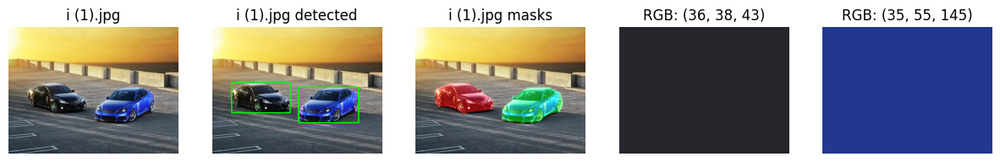


0: 448x640 (no detections), 614.3ms
Speed: 1.0ms preprocess, 614.3ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)


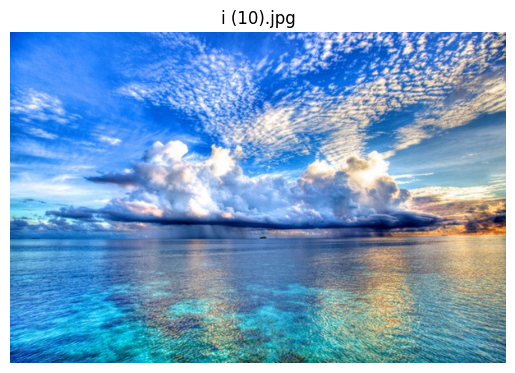

На фотографии автомобилей не обнаружено

0: 384x640 1 person, 2 cars, 542.8ms
Speed: 2.0ms preprocess, 542.8ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)


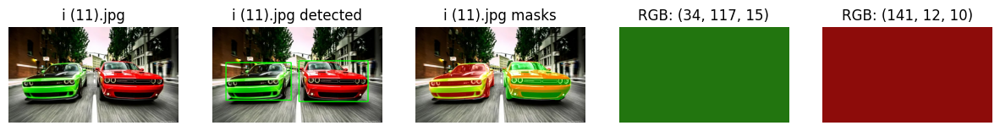


0: 416x640 2 cars, 579.5ms
Speed: 1.0ms preprocess, 579.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


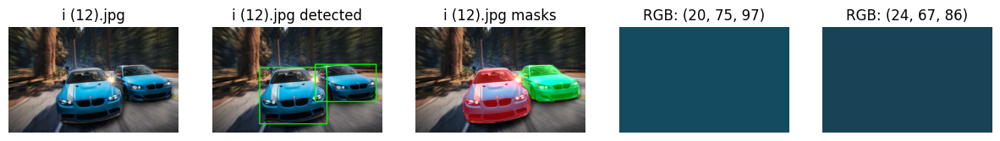


0: 384x640 1 car, 514.8ms
Speed: 1.0ms preprocess, 514.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


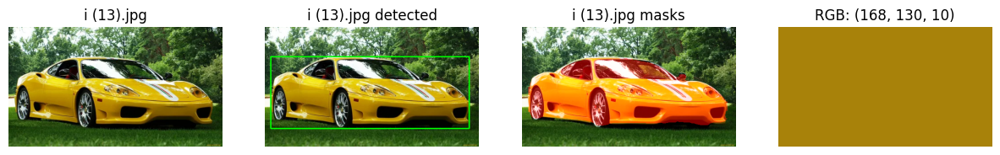


0: 416x640 1 car, 565.5ms
Speed: 1.0ms preprocess, 565.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


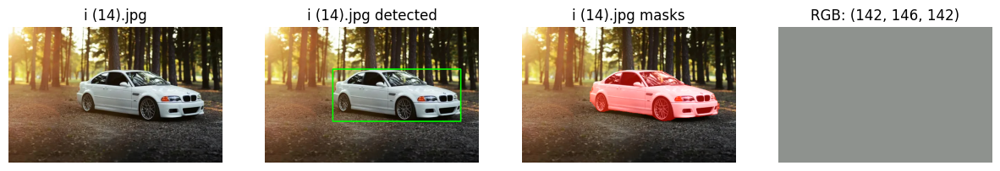


0: 384x640 1 car, 514.0ms
Speed: 1.0ms preprocess, 514.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


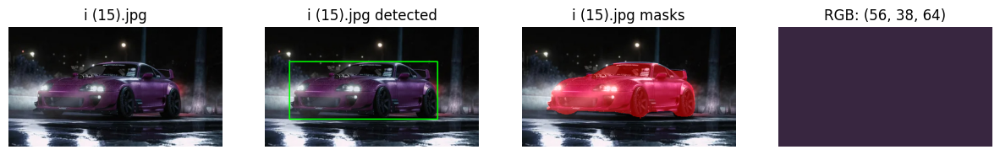


0: 384x640 2 cars, 511.9ms
Speed: 1.0ms preprocess, 511.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


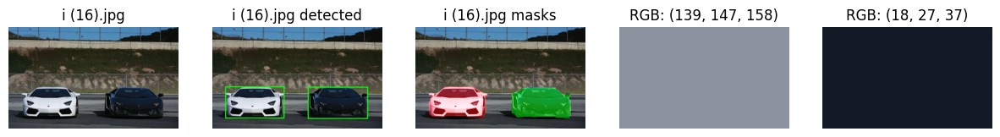


0: 384x640 3 cars, 537.7ms
Speed: 1.0ms preprocess, 537.7ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


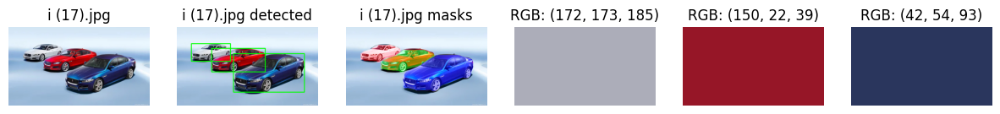


0: 480x640 4 cars, 1 boat, 638.2ms
Speed: 2.0ms preprocess, 638.2ms inference, 4.0ms postprocess per image at shape (1, 3, 480, 640)


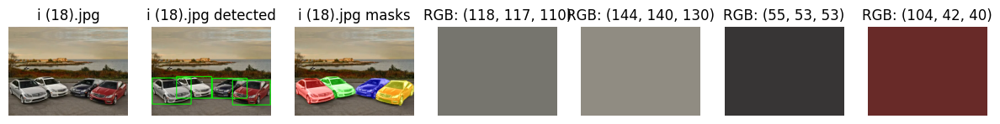


0: 384x640 1 car, 510.0ms
Speed: 1.0ms preprocess, 510.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


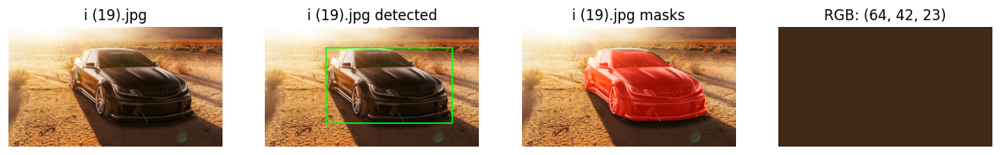


0: 384x640 1 dog, 1 bear, 521.8ms
Speed: 1.0ms preprocess, 521.8ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


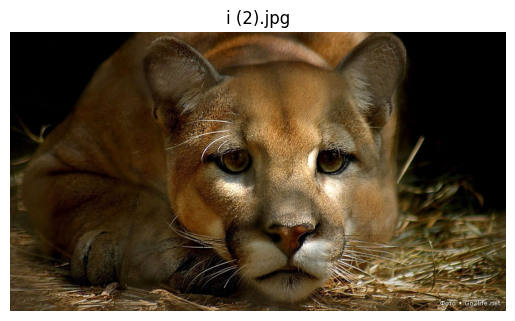

На фотографии автомобилей не обнаружено

0: 480x640 1 car, 624.8ms
Speed: 1.5ms preprocess, 624.8ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


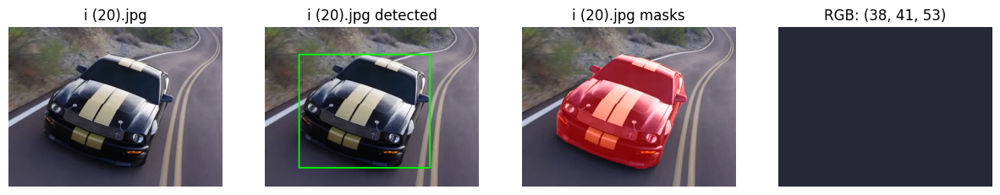


0: 384x640 1 car, 517.4ms
Speed: 1.0ms preprocess, 517.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


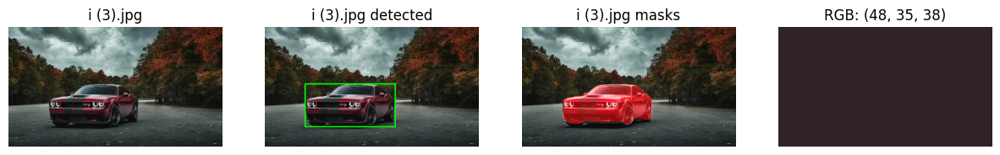


0: 416x640 2 cars, 561.1ms
Speed: 1.0ms preprocess, 561.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


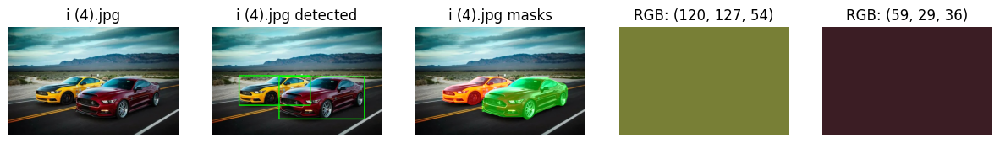


0: 416x640 2 cars, 548.1ms
Speed: 1.0ms preprocess, 548.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


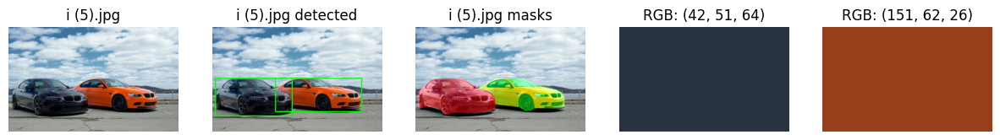


0: 352x640 3 cars, 494.2ms
Speed: 1.0ms preprocess, 494.2ms inference, 2.0ms postprocess per image at shape (1, 3, 352, 640)


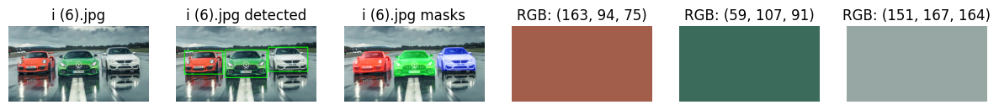


0: 352x640 5 cars, 480.1ms
Speed: 1.0ms preprocess, 480.1ms inference, 3.0ms postprocess per image at shape (1, 3, 352, 640)


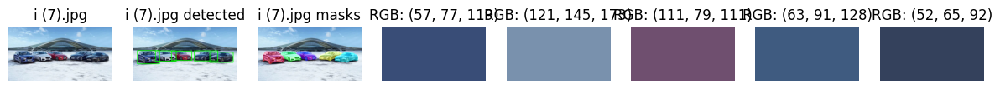


0: 448x640 2 cars, 606.9ms
Speed: 1.0ms preprocess, 606.9ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


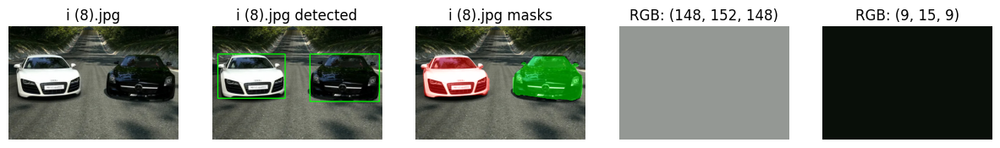


0: 416x640 1 car, 554.1ms
Speed: 1.0ms preprocess, 554.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


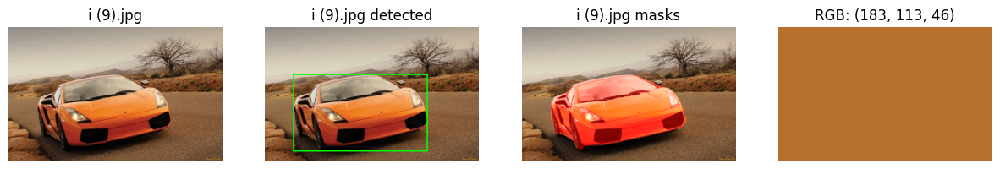

In [18]:
model = YOLO('yolov8x-seg.pt')

# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes, masks = detect_cars_with_segmentation(image_path, model)
    average_colors = extract_car_colors_v4(image_path=image_path, boxes=boxes, masks=masks)
    display_images_v3(image_path, rgb_list= average_colors, boxes=boxes, masks=masks)


Результаты с применением кластеризации


0: 480x640 2 cars, 639.7ms
Speed: 2.5ms preprocess, 639.7ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 640)


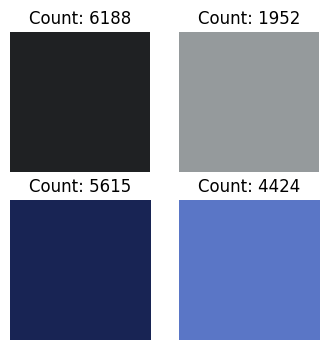

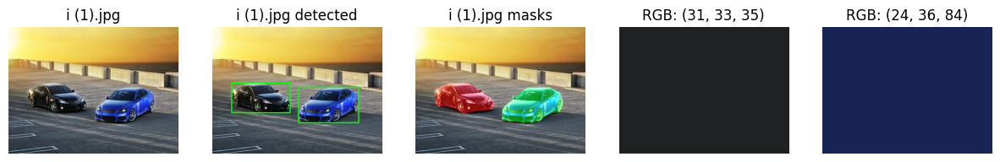


0: 448x640 (no detections), 585.7ms
Speed: 1.0ms preprocess, 585.7ms inference, 0.0ms postprocess per image at shape (1, 3, 448, 640)


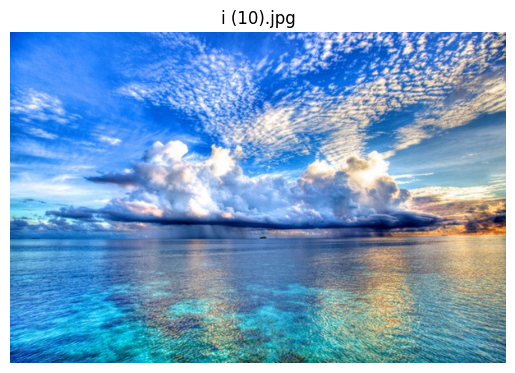

На фотографии автомобилей не обнаружено

0: 384x640 1 person, 2 cars, 511.4ms
Speed: 1.0ms preprocess, 511.4ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)


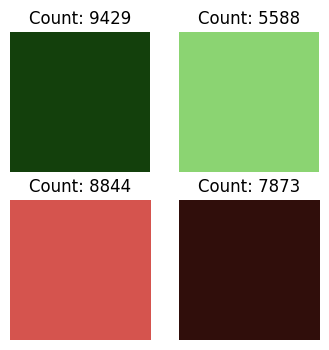

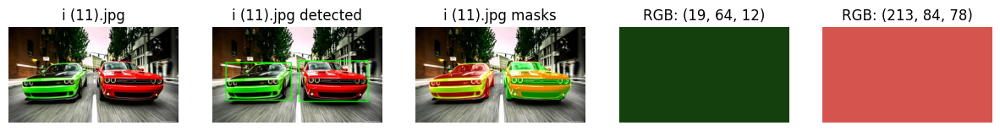


0: 416x640 2 cars, 552.5ms
Speed: 1.0ms preprocess, 552.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


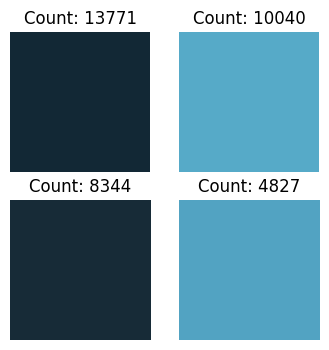

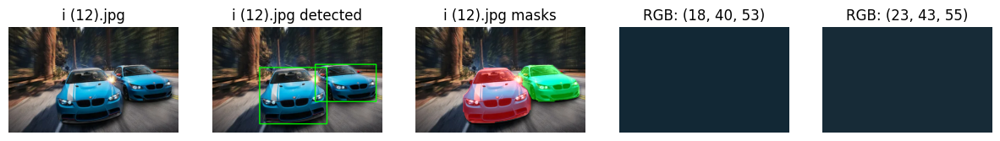


0: 384x640 1 car, 507.7ms
Speed: 1.0ms preprocess, 507.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


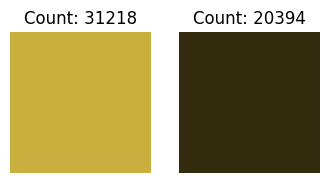

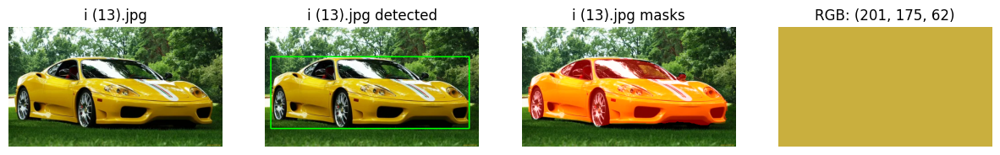


0: 416x640 1 car, 563.6ms
Speed: 1.0ms preprocess, 563.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


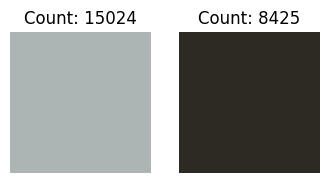

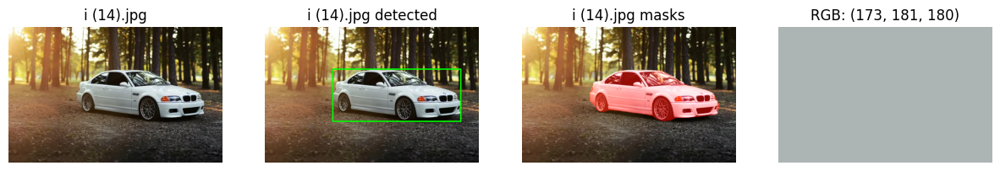


0: 384x640 1 car, 513.4ms
Speed: 1.0ms preprocess, 513.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


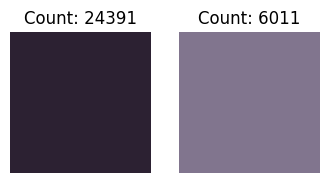

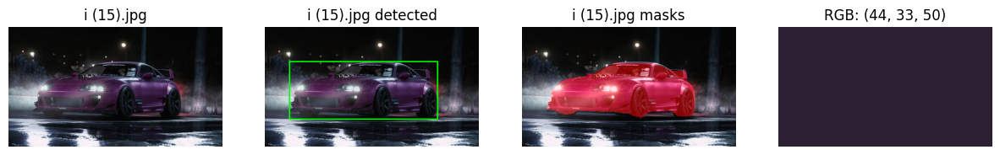


0: 384x640 2 cars, 508.3ms
Speed: 2.0ms preprocess, 508.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


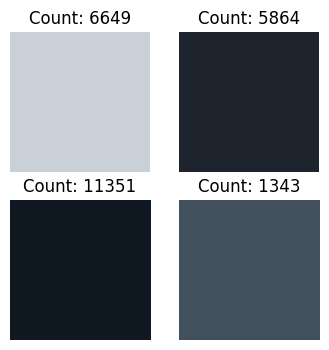

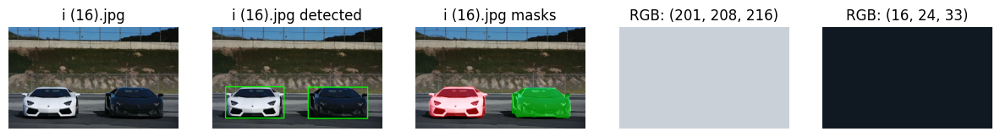


0: 384x640 3 cars, 511.8ms
Speed: 1.0ms preprocess, 511.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


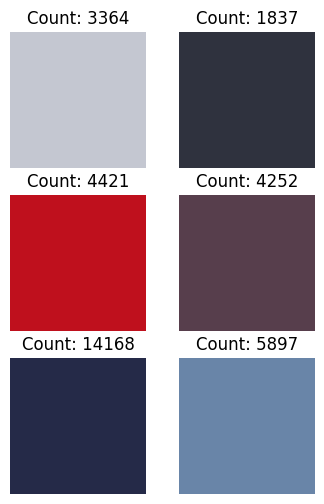

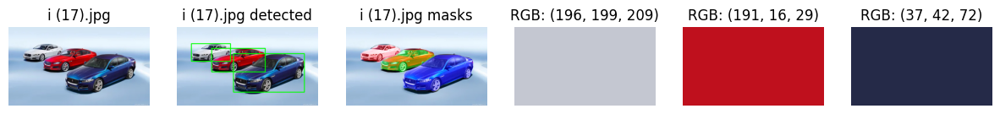


0: 480x640 4 cars, 1 boat, 629.5ms
Speed: 1.0ms preprocess, 629.5ms inference, 4.0ms postprocess per image at shape (1, 3, 480, 640)


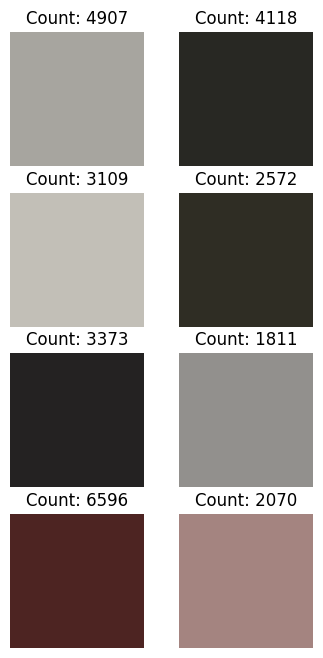

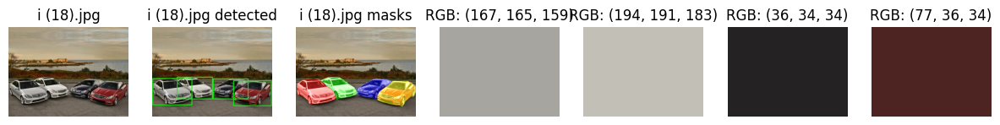


0: 384x640 1 car, 511.0ms
Speed: 1.0ms preprocess, 511.0ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


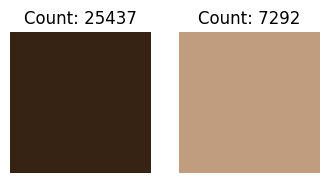

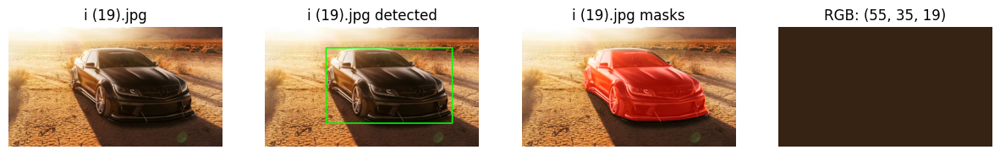


0: 384x640 1 dog, 1 bear, 511.9ms
Speed: 1.0ms preprocess, 511.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


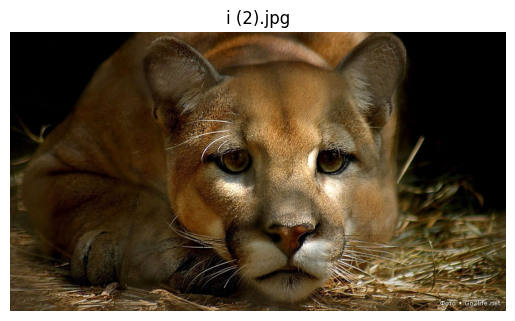

На фотографии автомобилей не обнаружено

0: 480x640 1 car, 628.2ms
Speed: 1.0ms preprocess, 628.2ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


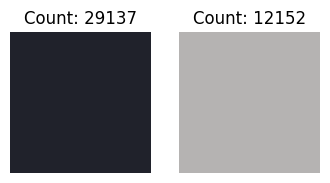

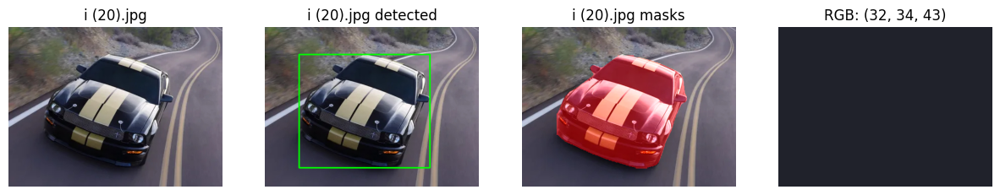


0: 384x640 1 car, 547.2ms
Speed: 1.0ms preprocess, 547.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


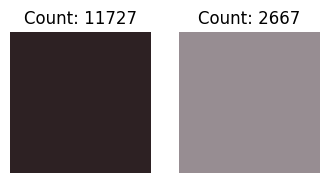

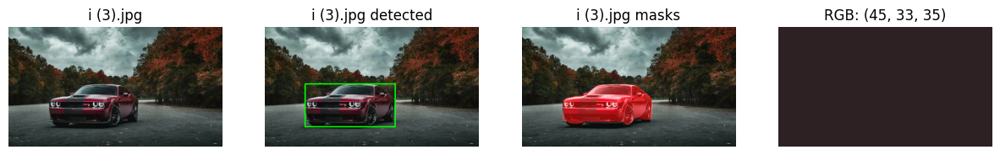


0: 416x640 2 cars, 549.5ms
Speed: 1.0ms preprocess, 549.5ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


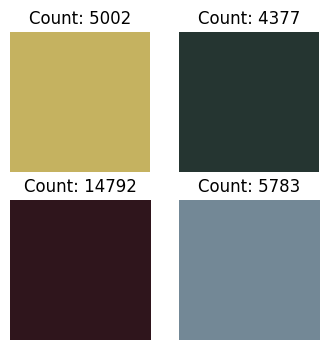

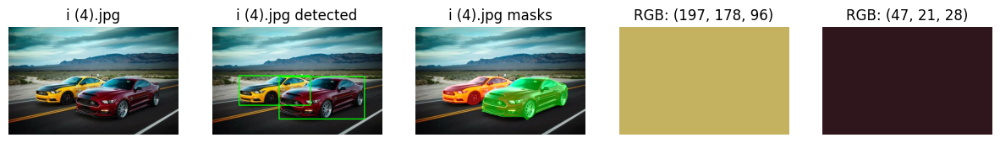


0: 416x640 2 cars, 552.8ms
Speed: 1.0ms preprocess, 552.8ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


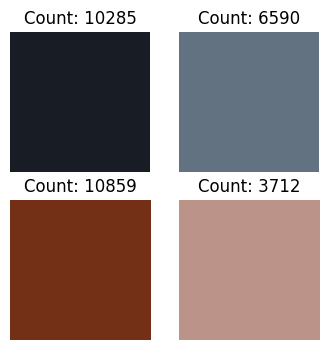

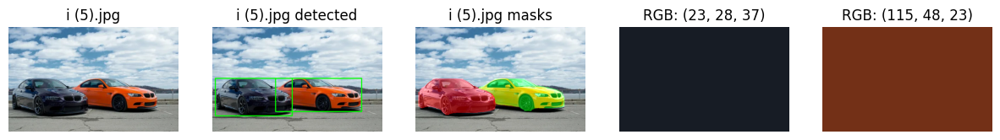


0: 352x640 3 cars, 473.3ms
Speed: 1.0ms preprocess, 473.3ms inference, 3.0ms postprocess per image at shape (1, 3, 352, 640)


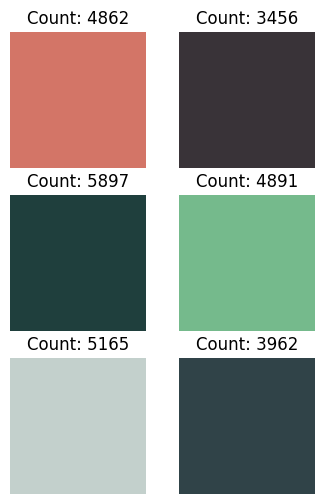

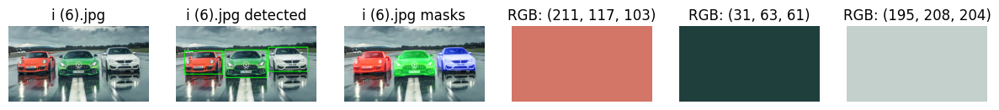


0: 352x640 5 cars, 472.9ms
Speed: 1.0ms preprocess, 472.9ms inference, 3.0ms postprocess per image at shape (1, 3, 352, 640)


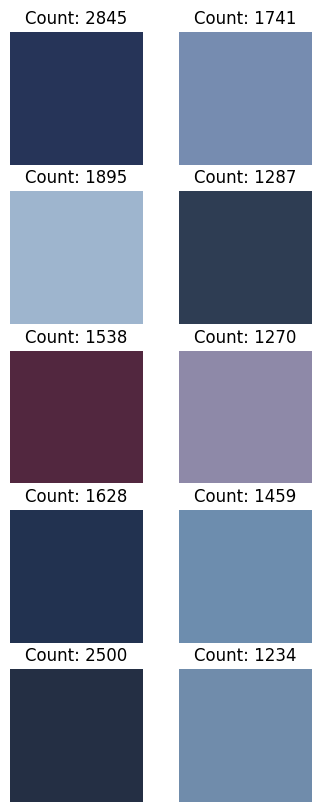

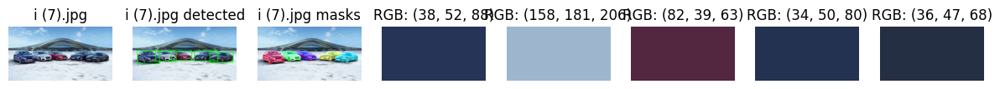


0: 448x640 2 cars, 586.7ms
Speed: 1.0ms preprocess, 586.7ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)


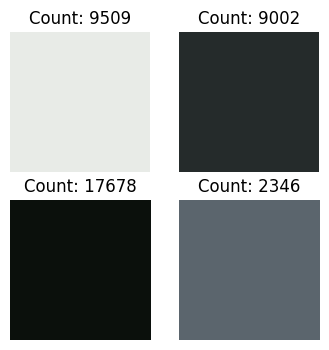

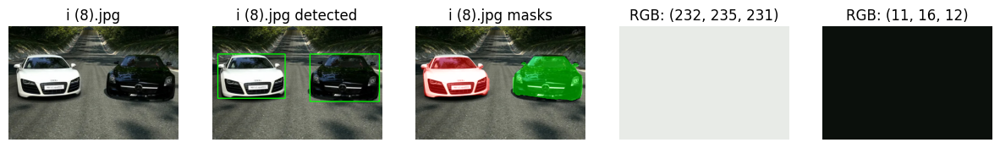


0: 416x640 1 car, 550.3ms
Speed: 1.0ms preprocess, 550.3ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


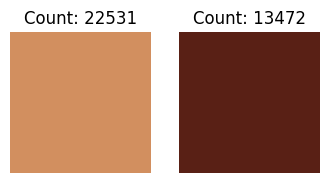

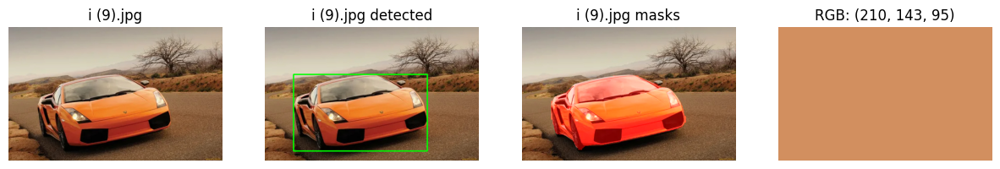

In [19]:
# В цикле обработаем наш датасет
for filename in os.listdir('data'):
    image_path = os.path.join('data', filename)
    boxes, masks = detect_cars_with_segmentation(image_path, model)
    clusters_count = 2
    dominant_colors, all_cluster_centers_counts = extract_car_colors_v5_all(image_path=image_path, boxes=boxes, masks=masks, k=clusters_count)
    visualize_clusters(all_cluster_centers_counts, clusters_count=clusters_count)
    display_images_v3(image_path, rgb_list=dominant_colors, boxes=boxes, masks=masks)

In [20]:
## Итоги

Подход № 4 на мой взгляд оказался самым успешным.

Чтобы не удлинять и без того длинный ноутбук все прочие эксперименты были удалены, потому что не принесли улучшения качества.

Было испытано:
1. Разное количество кластеров.(Самым оптимальным вариантом оказалось число 2, иначе начинал доминировать черный, а палитра становилась очень разнообразна и далека от требуемой)
2. Другие методы кластеризации.(Наличие более 2 кластеров приводит к проблеме 1)
3. Другие методы выбора главного кластера: дисперсия, сравнение со средним, сравнение с медианой и так далее (или увеличивается количество совсем неточных предсказаний или результаты сравнимые, но реализация сложнее)
4. Также были попытки построить что-то вроде распределения, как по каналам так и в градациях серого. С его помощью хотелось обрезать колеса, фары, стекла и прочие лишние элементы.(Не удалось получить информативного распределения, по которому можно было бы с большой уверенностью что-то вырезать из картинки. Черный автомобиль на ярком свете имеет показатели rgb сильно выше чем темный автомобиль в ночное время суток)

Итого получилось 2 близких по качеству подхода к решению задачи. Метод с медианой меньше ошибается, а метод с кластеризацией чаще выдает более точные цвета. Особенно это касается черных и белых автомобилей.

Если рассматривать методы машинного обучения для решения этой задачи, то я не смог найти похожих примеров с хорошими результатами, готовых датасетов и тем более обученных моделей. Думаю многослойная сверточная нейронная сеть, обученная на регрессию по 3 каналам rgb на больших обьемах данных может и смогла бы решить эту задачу, но результаты были бы всеравно не идеальные. 

Нужно какое-то практическое применение этой задачи, чтобы выбрать правильную метрику качества и стремится улучшить именно ее.



### Финальная проверка

В завершении проверим нашу программу на новых данных

0: 480x640 2 cars, 632.9ms
Speed: 2.0ms preprocess, 632.9ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


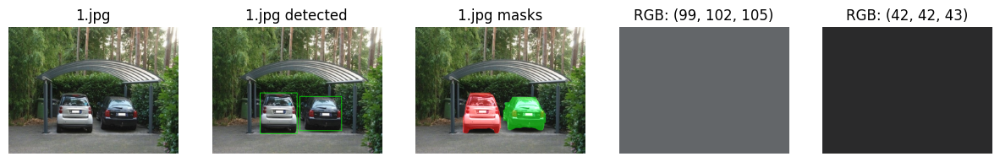


0: 416x640 2 persons, 2 cars, 547.3ms
Speed: 2.0ms preprocess, 547.3ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 640)


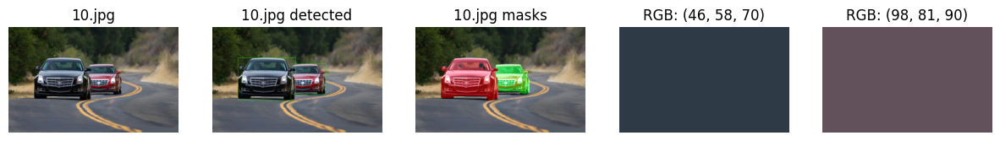


0: 288x640 1 car, 430.3ms
Speed: 1.0ms preprocess, 430.3ms inference, 2.0ms postprocess per image at shape (1, 3, 288, 640)


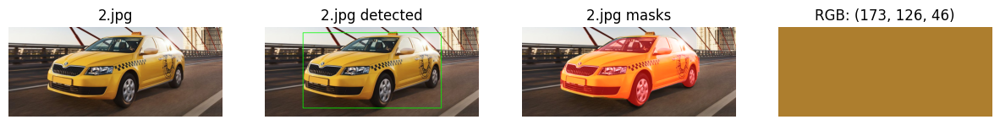


0: 416x640 1 car, 549.9ms
Speed: 2.0ms preprocess, 549.9ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


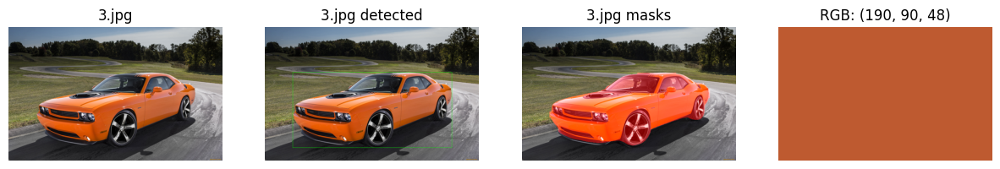


0: 448x640 2 cars, 588.9ms
Speed: 2.0ms preprocess, 588.9ms inference, 3.0ms postprocess per image at shape (1, 3, 448, 640)


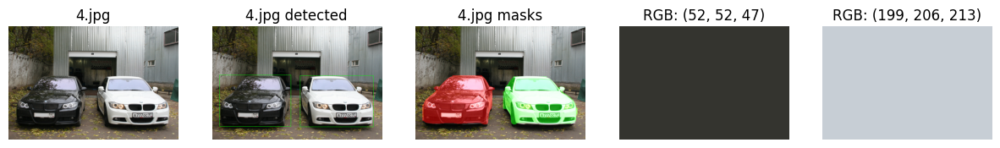


0: 480x640 1 car, 1 potted plant, 630.8ms
Speed: 2.0ms preprocess, 630.8ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 640)


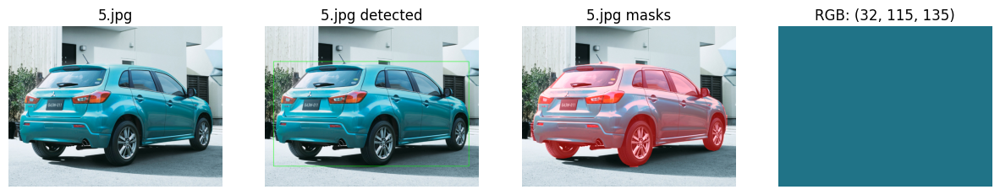


0: 384x640 2 cars, 507.9ms
Speed: 2.0ms preprocess, 507.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


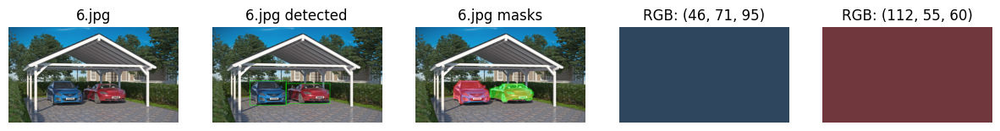


0: 416x640 1 car, 554.6ms
Speed: 2.0ms preprocess, 554.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


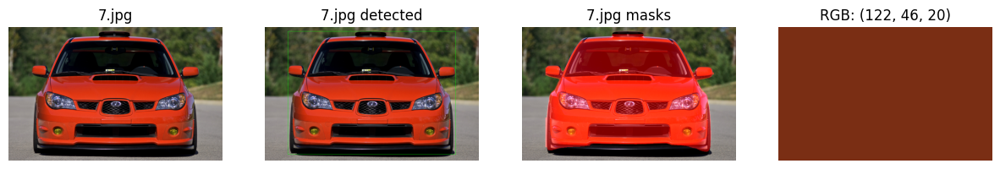


0: 384x640 1 person, 2 cars, 515.0ms
Speed: 2.0ms preprocess, 515.0ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


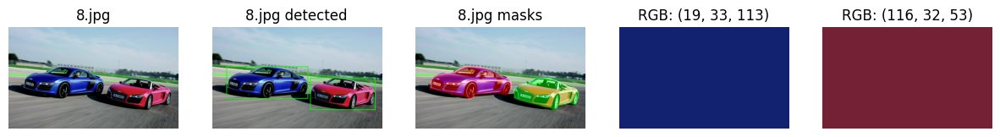


0: 416x640 1 car, 557.0ms
Speed: 1.0ms preprocess, 557.0ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


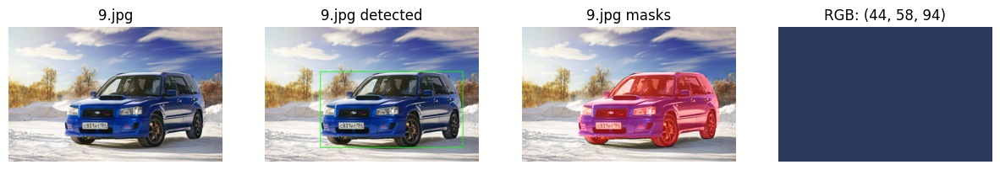

In [21]:
for filename in os.listdir('data_test'):
    image_path = os.path.join('data_test', filename)
    boxes, masks = detect_cars_with_segmentation(image_path, model)
    dominant_colors = extract_car_colors_v4(image_path=image_path, boxes=boxes, masks=masks)
    display_images_v3(image_path, rgb_list=dominant_colors, boxes=boxes, masks=masks)


0: 480x640 2 cars, 635.1ms
Speed: 2.0ms preprocess, 635.1ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 640)


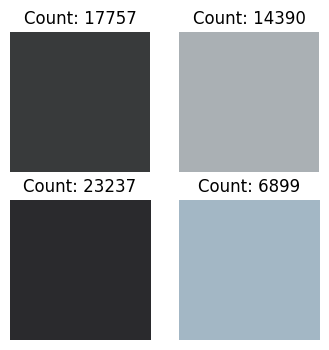

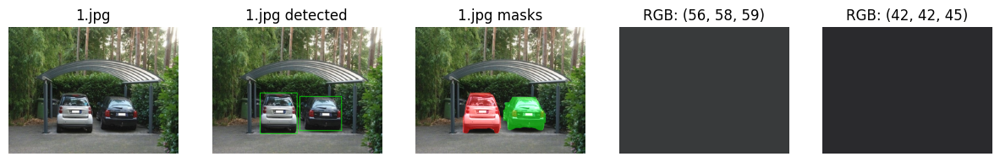


0: 416x640 2 persons, 2 cars, 556.0ms
Speed: 2.0ms preprocess, 556.0ms inference, 3.0ms postprocess per image at shape (1, 3, 416, 640)


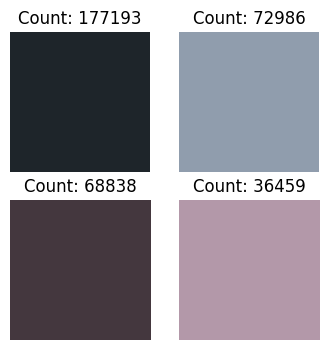

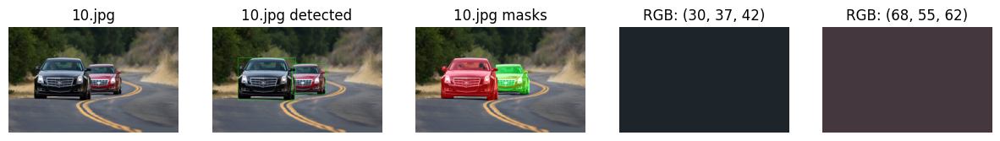


0: 288x640 1 car, 395.9ms
Speed: 1.0ms preprocess, 395.9ms inference, 1.0ms postprocess per image at shape (1, 3, 288, 640)


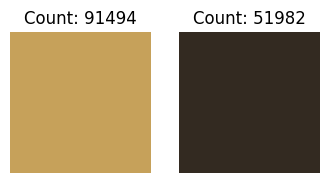

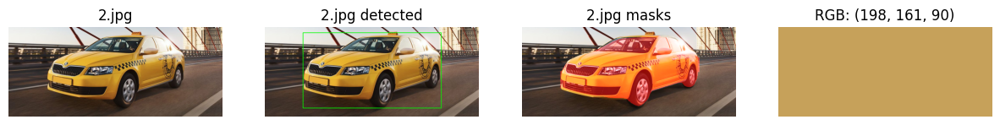


0: 416x640 1 car, 559.8ms
Speed: 1.0ms preprocess, 559.8ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 640)


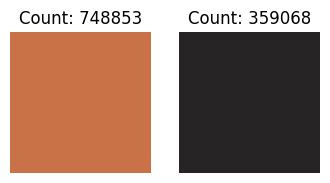

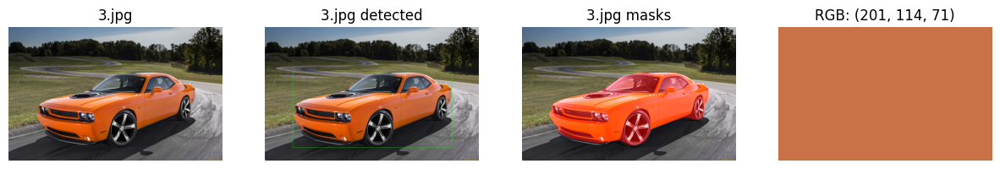


0: 448x640 2 cars, 613.4ms
Speed: 2.0ms preprocess, 613.4ms inference, 2.6ms postprocess per image at shape (1, 3, 448, 640)


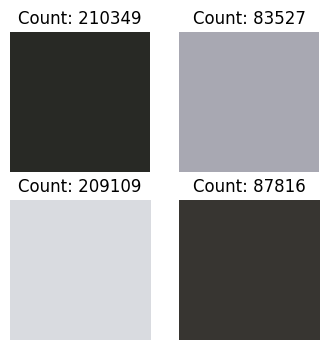

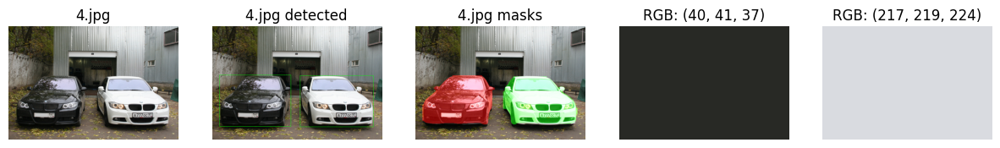


0: 480x640 1 car, 1 potted plant, 634.6ms
Speed: 3.0ms preprocess, 634.6ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


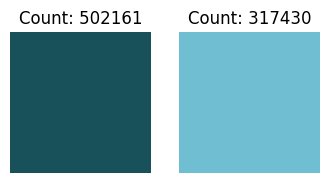

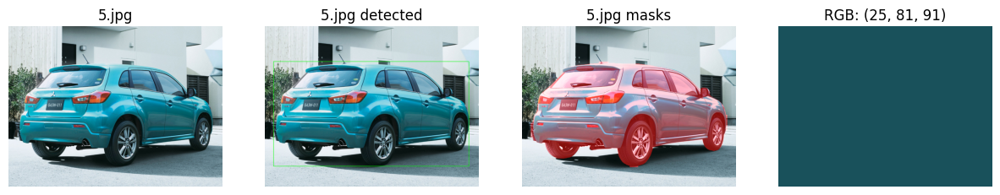


0: 384x640 2 cars, 510.8ms
Speed: 1.0ms preprocess, 510.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


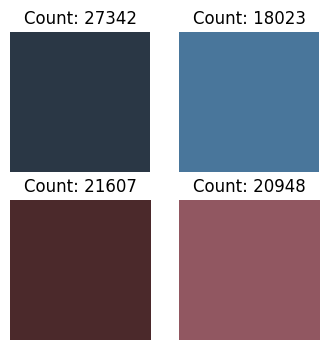

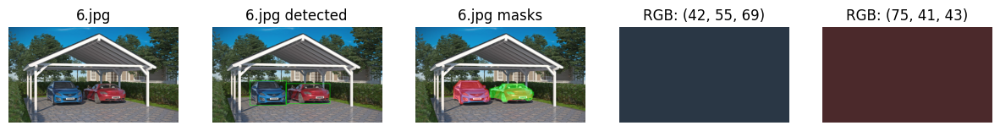


0: 416x640 1 car, 554.1ms
Speed: 2.0ms preprocess, 554.1ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


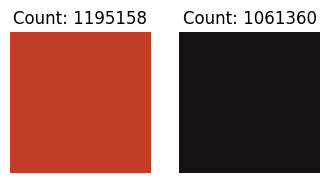

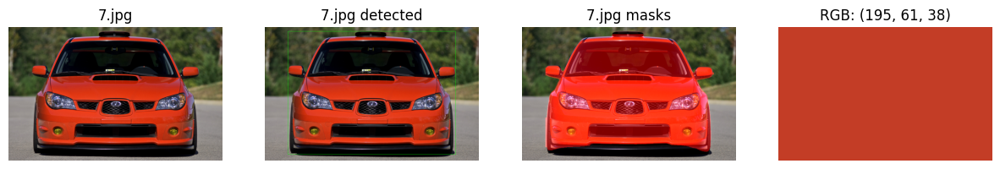


0: 384x640 1 person, 2 cars, 538.6ms
Speed: 1.0ms preprocess, 538.6ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


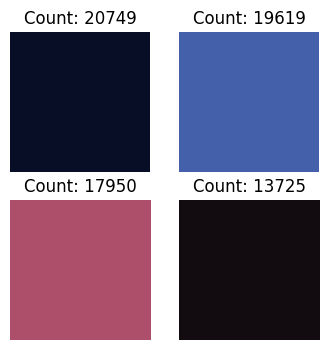

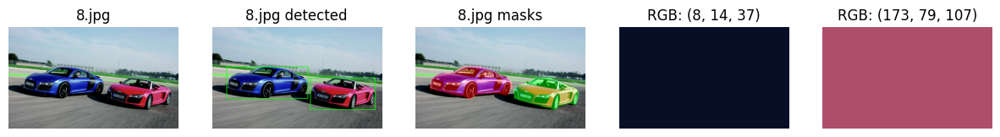


0: 416x640 1 car, 566.2ms
Speed: 1.0ms preprocess, 566.2ms inference, 1.0ms postprocess per image at shape (1, 3, 416, 640)


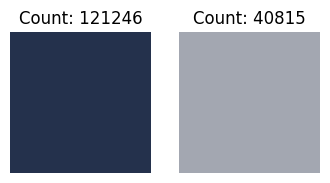

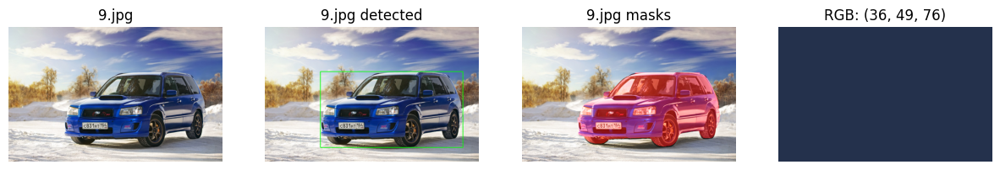

In [22]:
for filename in os.listdir('data_test'):
    image_path = os.path.join('data_test', filename)
    boxes, masks = detect_cars_with_segmentation(image_path, model)
    clusters_count = 2
    dominant_colors, all_cluster_centers_counts = extract_car_colors_v5_all(image_path=image_path, boxes=boxes, masks=masks, k=clusters_count)
    visualize_clusters(all_cluster_centers_counts, clusters_count=clusters_count)
    display_images_v3(image_path, rgb_list=dominant_colors, boxes=boxes, masks=masks)

На новых данных подход с медианой показал себя немного лучше, думаю следует на нем остановится.